# Readme
--------------------------------------

Name: Sanket Jagtap
College: IIT Kharagpur

## Introduction

In this study, we analyze a dataset consisting of 90 distinct animal images. Our objective is to explore various classification tasks using this dataset. Initially, we will organize the data for one-vs-rest classification as binary classification, and addressing a 5-class classification challenge. To assess the efficacy of these two classification model, we will employ classification matrices for comprehensive evaluation.

## Classification Techniques

### One-vs-Rest Classification: 
Initially, we organize the dataset to facilitate one-vs-rest classification. This approach involves training a separate classifier for each class while treating all other classes as a single class. Consequently, we iteratively train multiple classifiers, each distinguishing between one class and the rest.

### 5-Class Classification:
Finally, we address a more complex classification scenario involving five distinct classes. This setup requires the development of a classification model capable of accurately assigning each input image to one of the five predefined classes.

## Model
The dataset underwent analysis utilizing three distinct architectures: CustomNN with attention mechanism, MobileNet, and EfficientNet. Across all cases examined, the test accuracy consistently surpassed the remarkable threshold of 99.5%.

## Evaluation

To gauge the effectiveness of each classification model, we employ classification matrices. These matrices provide a comprehensive overview of the model's performance by presenting key metrics such as accuracy, and precision, recall, and F1-score can be calculated by using the printed confusion matrix for each class. By analyzing these metrics, we can identify the strengths and weaknesses of each classification approach, enabling informed decision-making regarding model selection and refinement.

-------------------------------------------
# Libraries

Used for Folder Structure


In [1]:
import os 
from PIL import Image
import shutil
import random

Used for DL and Visualisation

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset

import torchvision
from torchvision import transforms

from sklearn.model_selection import KFold, train_test_split
from sklearn.metrics import confusion_matrix, roc_curve, auc, accuracy_score

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


# Folder Structure

Study of Image type and folder structure for further analysis

In [3]:
# The folder is contained in this directory
animal_dir = "/kaggle/input/animal-image-dataset-90-different-animals/animals/animals"

In [4]:

len(os.listdir(animal_dir))

90

In [5]:
with open("/kaggle/input/animal-image-dataset-90-different-animals/name of the animals.txt", 'r') as f:
    animal_info = f.read()

In [6]:
print(animal_info.split())

['antelope', 'badger', 'bat', 'bear', 'bee', 'beetle', 'bison', 'boar', 'butterfly', 'cat', 'caterpillar', 'chimpanzee', 'cockroach', 'cow', 'coyote', 'crab', 'crow', 'deer', 'dog', 'dolphin', 'donkey', 'dragonfly', 'duck', 'eagle', 'elephant', 'flamingo', 'fly', 'fox', 'goat', 'goldfish', 'goose', 'gorilla', 'grasshopper', 'hamster', 'hare', 'hedgehog', 'hippopotamus', 'hornbill', 'horse', 'hummingbird', 'hyena', 'jellyfish', 'kangaroo', 'koala', 'ladybugs', 'leopard', 'lion', 'lizard', 'lobster', 'mosquito', 'moth', 'mouse', 'octopus', 'okapi', 'orangutan', 'otter', 'owl', 'ox', 'oyster', 'panda', 'parrot', 'pelecaniformes', 'penguin', 'pig', 'pigeon', 'porcupine', 'possum', 'raccoon', 'rat', 'reindeer', 'rhinoceros', 'sandpiper', 'seahorse', 'seal', 'shark', 'sheep', 'snake', 'sparrow', 'squid', 'squirrel', 'starfish', 'swan', 'tiger', 'turkey', 'turtle', 'whale', 'wolf', 'wombat', 'woodpecker', 'zebra']


In [7]:
len(animal_info.split())

90

In [8]:

animal_names = {} 
animal_directories = os.listdir(animal_dir)

for animal_name in animal_directories:
    animal_path = os.path.join(animal_dir, animal_name)
    num_images = len(os.listdir(animal_path))
    animal_names[animal_name] = num_images

In [9]:
animal_names

{'beetle': 60,
 'parrot': 60,
 'fox': 60,
 'wolf': 60,
 'hedgehog': 60,
 'turtle': 60,
 'snake': 60,
 'shark': 60,
 'horse': 60,
 'antelope': 60,
 'hamster': 60,
 'woodpecker': 60,
 'eagle': 60,
 'chimpanzee': 60,
 'bison': 60,
 'penguin': 60,
 'butterfly': 60,
 'sandpiper': 60,
 'hornbill': 60,
 'lion': 60,
 'lobster': 60,
 'oyster': 60,
 'otter': 60,
 'grasshopper': 60,
 'raccoon': 60,
 'dog': 60,
 'pigeon': 60,
 'donkey': 60,
 'hippopotamus': 60,
 'hummingbird': 60,
 'bear': 60,
 'coyote': 60,
 'bee': 60,
 'pig': 60,
 'rat': 60,
 'owl': 60,
 'caterpillar': 60,
 'koala': 60,
 'squid': 60,
 'hare': 60,
 'whale': 60,
 'mouse': 60,
 'tiger': 60,
 'fly': 60,
 'lizard': 60,
 'orangutan': 60,
 'bat': 60,
 'porcupine': 60,
 'kangaroo': 60,
 'gorilla': 60,
 'starfish': 60,
 'mosquito': 60,
 'crow': 60,
 'possum': 60,
 'goldfish': 60,
 'swan': 60,
 'elephant': 60,
 'sheep': 60,
 'dragonfly': 60,
 'zebra': 60,
 'seal': 60,
 'octopus': 60,
 'cow': 60,
 'ox': 60,
 'wombat': 60,
 'reindeer': 60,


In [10]:

image_path = "/kaggle/input/animal-image-dataset-90-different-animals/animals/animals/antelope/02f4b3be2d.jpg"
image = Image.open(image_path)
width, height = image.size
print(f"width: {width}, height: {height}")

width: 1640, height: 1025


# **One vs Rest Classification**

This dataset class retrieves all images from the folder at the `ith` index, as well as `10%` of the images from each of the other folders. This approach helps to conserve memory and end potential train and test problems arising from significant discrepancies in image numbers across folders.


```
Note: Earlier the dataset took `ith` folder (60) images, and (5340) images in the rest folder, but this caused errors so, in the final version of the code this issue was solved using this method.
```

In [11]:
path = "/kaggle/input/animal-image-dataset-90-different-animals/animals/animals"

In the transform, the mean is ```mean=[0.485, 0.456, 0.406]``` and ```std=[0.229, 0.224, 0.225]``` to normalize images because it is given by PyTorch by default and is the Imagenet default values and in practice it is assumed to work better then rest values.

The label is 0 and 1.

In [12]:
class dataset_new(torch.utils.data.Dataset):
    def __init__(self,data_idx,take=0.1,path=path):
        super().__init__()
        classes = os.listdir(path)
        folder_name = classes[data_idx]
        self.images = []
        self.labels = []
        self.transforms = transforms.Compose([
            transforms.Resize(256), # 256 for efficient net , 224
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
            ])
        for folder in classes:
            if folder==folder_name:
                limit = 1
            else:
                limit = take
            anim_fold = os.path.join(path, folder)
            for l,localpath in enumerate(os.listdir(anim_fold)):
                if(l>=limit*len(os.listdir(anim_fold))):
                    break
                img_path = os.path.join(anim_fold, localpath)
                self.images.append(img_path)
                if folder==folder_name:
                    self.labels.append(1)
                else:
                    self.labels.append(0)
        
    def __len__(self):
        return len(self.images)
    def __getitem__(self,idx):
        img = Image.open(self.images[idx])
        label = self.labels[idx]
        return self.transforms(img), torch.tensor(label,dtype=torch.long)
      

```run_label_classification_one_vs_rest_fold```, this function is the main structure, and works to run the model using different models and perform calcualtions. It does 3fold CV with 3 epochs each using one_vs_rest and displays the test and train, accuracy and loss value after each epoch and also saves the plot.

In [13]:
def run_label_classification_one_vs_rest_fold(model_net, name):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    name_model = str(name)
    for i in range(90):
        print(animal_info.split()[i])
        dataset = dataset_new(i)

        kfold = KFold(n_splits=3, shuffle=True)

        print('--------------------------------')

        for fold, (train_ids, test_ids) in enumerate(kfold.split(dataset)):

            print(f'FOLD {fold}')
            print('--------------------------------')

            train_subsampler = torch.utils.data.SubsetRandomSampler(train_ids)
            test_subsampler = torch.utils.data.SubsetRandomSampler(test_ids)

            train_loader = DataLoader(dataset, batch_size=32, sampler=train_subsampler, pin_memory=True, num_workers=2)
            test_loader = DataLoader(dataset, batch_size=32, sampler=test_subsampler, pin_memory=True, num_workers=2)

            model = model_net
            model.to(device)

            optimizer = optim.Adam(model.parameters(), lr=5e-5)
            train_losses = []
            test_losses = []
            train_accuracies = []
            test_accuracies = []

            for epoch in range(3):

                model.train()
                correct = 0
                total = 0
                train_loss = 0.0
                for _, (inputs, labels) in enumerate(train_loader):
                    inputs, labels = inputs.to(device), labels.to(device)
                    optimizer.zero_grad()

                    outputs = model(inputs)
                    loss = nn.CrossEntropyLoss()(outputs, labels)
                    loss.backward()
                    optimizer.step()
                    train_loss += loss.item()
                    _, predicted = outputs.max(1)
                    total += labels.size(0)
                    correct += predicted.eq(labels).sum().item()

                model.eval()  
                test_loss = 0.0
                test_correct = 0
                test_total = 0
                all_labels = []
                all_predictions = []

                for inputs, labels in test_loader:
                    inputs, labels = inputs.to(device), labels.to(device)
                    outputs = model(inputs)
                    loss = nn.CrossEntropyLoss()(outputs, labels)
                    test_loss += loss.item()*inputs.size(0)
                    _, predicted = outputs.max(1)
                    test_total += labels.size(0)
                    test_correct += predicted.eq(labels).sum().item()
                    all_labels.extend(labels.cpu().numpy())
                    all_predictions.extend(predicted.cpu().numpy())


                test_loss = test_loss / len(test_loader)
                train_loss = train_loss/len(train_loader)
                test_accuracy = 100.0 * correct / total
                train_accuracy = 100.0 * test_correct/test_total

                train_losses.append(train_loss)
                test_losses.append(test_loss)
                train_accuracies.append(train_accuracy)
                test_accuracies.append(test_accuracy)

                print('Epoch: {} \tTraining Loss: {:.6f} \tTest Loss: {:.6f} \tTrain Accuracy {:.6f}% \tTest Accuracy: {:.2f}%'.format(
                    epoch+1, 
                    train_loss,
                    test_loss,
                    train_accuracy,
                    test_accuracy
                    ))
                
            directory = f'/kaggle/working/one-vs-rest/{name}/{animal_info.split()[i]}/'
            os.makedirs(directory, exist_ok=True)

            plt.figure(figsize=(10, 5))
            plt.plot(train_accuracies, label='Train Accuracy')
            plt.plot(test_accuracies, label='Test Accuracy')
            plt.title('Accuracy Curve for Dataset Name: {} Fold {}'.format(animal_info.split()[i], fold))
            plt.xlabel('Epoch')
            plt.ylabel('Accuracy')
            plt.savefig(os.path.join(directory, f'{fold}.png'))


            print('Confusion Matrix for fold {}'.format(fold))
            print(confusion_matrix(all_labels, all_predictions))

Model using Efficientnet b0

In [14]:
!pip install efficientnet_pytorch



  Preparing metadata (setup.py) ... done












  Created wheel for efficientnet_pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16428 sha256=5c9a2676be93efb6f4ae22a0e0d1392c2cf45ad9c9788cc9bac062bc5d0188e6

  Stored in directory: /root/.cache/pip/wheels/03/3f/e9/911b1bc46869644912bda90a56bcf7b960f20b5187feea3baf

Successfully built efficientnet_pytorch




Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b0-355c32eb.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b0-355c32eb.pth

100%|██████████| 20.4M/20.4M [00:00<00:00, 283MB/s]


Loaded pretrained weights for efficientnet-b0

antelope

--------------------------------

FOLD 0

--------------------------------

Epoch: 1 	Training Loss: 0.483843 	Test Loss: 9.455644 	Train Accuracy 91.919192% 	Test Accuracy: 75.51%

Epoch: 2 	Training Loss: 0.220881 	Test Loss: 6.204430 	Train Accuracy 91.919192% 	Test Accuracy: 93.94%

Epoch: 3 	Training Loss: 0.131548 	Test Loss: 5.057704 	Train Accuracy 93.434343% 	Test Accuracy: 95.71%

Confusion Matrix for fold 0

[[170  12]

 [  1  15]]

FOLD 1

--------------------------------

Epoch: 1 	Training Loss: 0.103036 	Test Loss: 4.487078 	Train Accuracy 94.444444% 	Test Accuracy: 96.72%

Epoch: 2 	Training Loss: 0.043193 	Test Loss: 4.123268 	Train Accuracy 94.444444% 	Test Accuracy: 99.24%

Epoch: 3 	Training Loss: 0.035439 	Test Loss: 3.681871 	Train Accuracy 94.444444% 	Test Accuracy: 98.99%

Confusion Matrix for fold 1

[[170   9]

 [  2  17]]

FOLD 2

--------------------------------

Epoch: 1 	Training Loss: 0.039905 	Test

/tmp/ipykernel_25/2747969893.py:91: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.

  plt.figure(figsize=(10, 5))


--------------------------------

FOLD 0

--------------------------------

Epoch: 1 	Training Loss: 0.509013 	Test Loss: 7.490584 	Train Accuracy 91.919192% 	Test Accuracy: 89.65%

Epoch: 2 	Training Loss: 0.117622 	Test Loss: 4.399207 	Train Accuracy 96.464646% 	Test Accuracy: 95.71%

Epoch: 3 	Training Loss: 0.061678 	Test Loss: 4.013577 	Train Accuracy 96.969697% 	Test Accuracy: 98.48%

Confusion Matrix for fold 0

[[178   3]

 [  3  14]]

FOLD 1

--------------------------------

Epoch: 1 	Training Loss: 0.082305 	Test Loss: 0.531998 	Train Accuracy 99.494949% 	Test Accuracy: 97.22%

Epoch: 2 	Training Loss: 0.020727 	Test Loss: 0.393779 	Train Accuracy 99.494949% 	Test Accuracy: 99.49%

Epoch: 3 	Training Loss: 0.009517 	Test Loss: 0.386513 	Train Accuracy 99.494949% 	Test Accuracy: 99.75%

Confusion Matrix for fold 1

[[171   1]

 [  0  26]]

FOLD 2

--------------------------------

Epoch: 1 	Training Loss: 0.014956 	Test Loss: 0.078842 	Train Accuracy 100.000000% 	Test Accurac

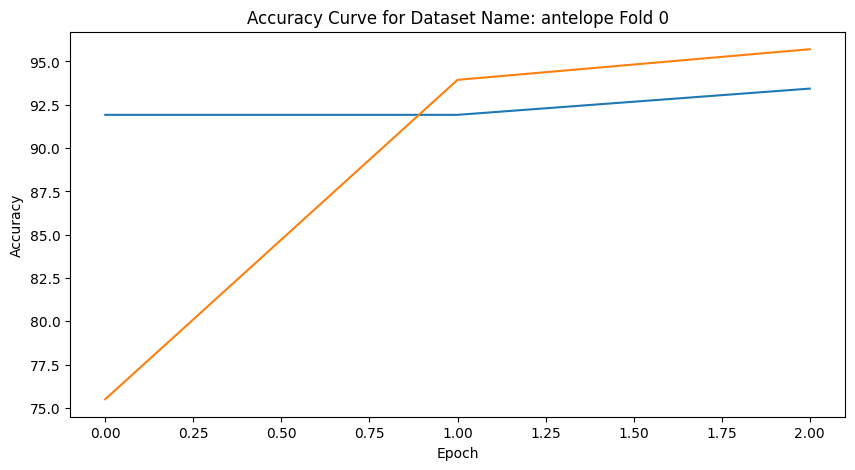

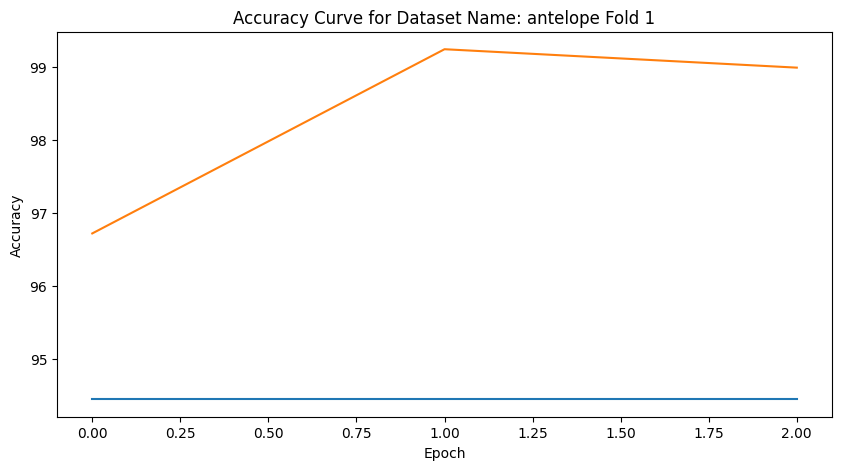

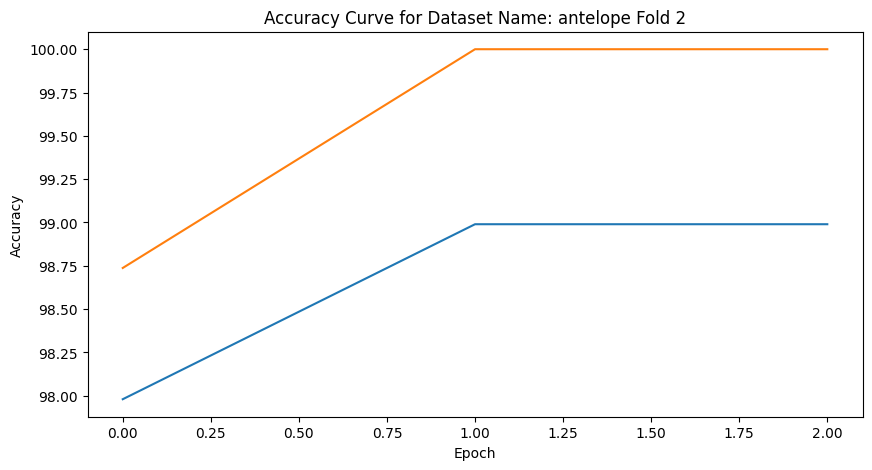

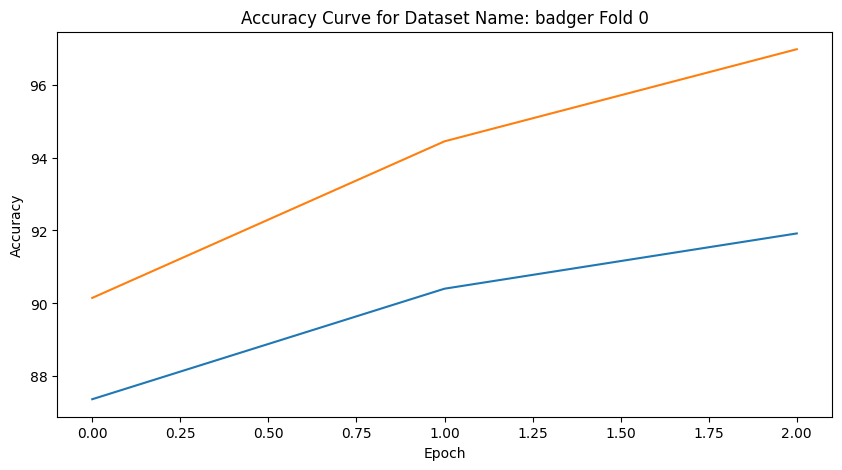

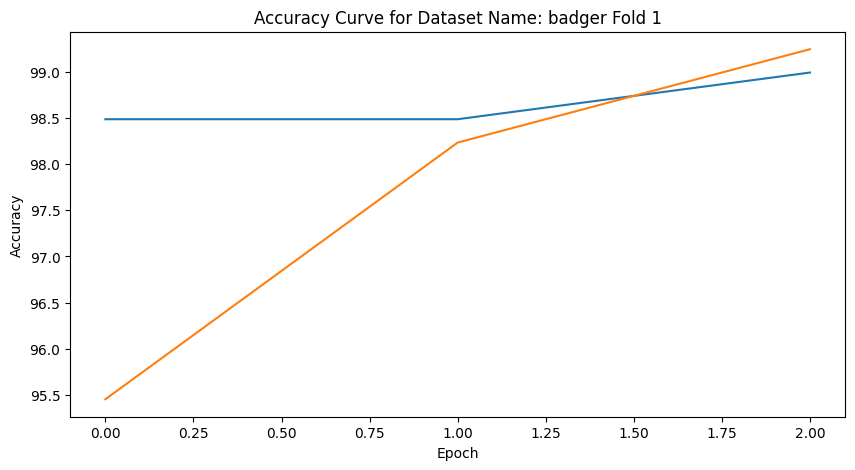

...

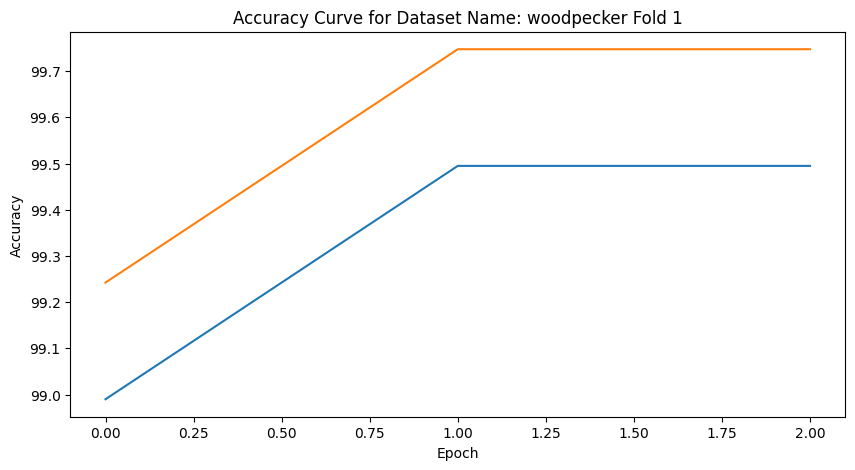

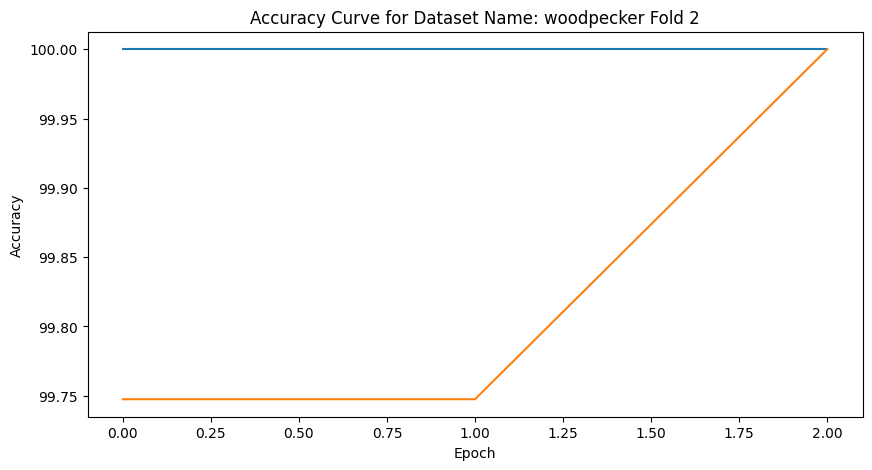

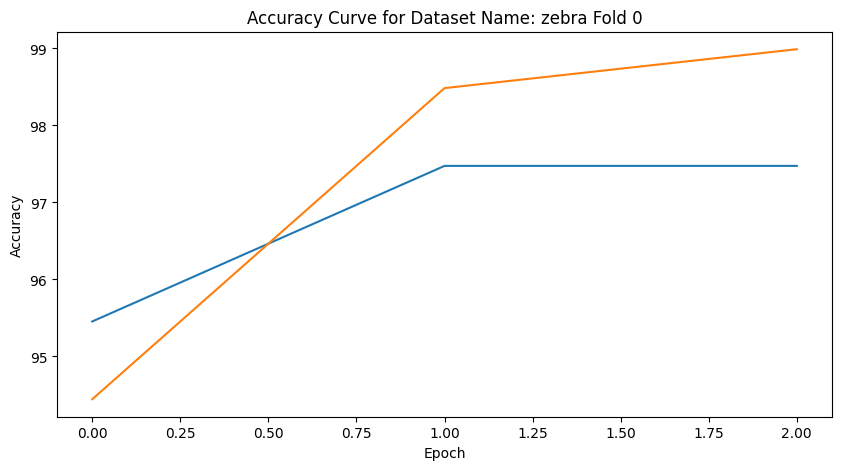

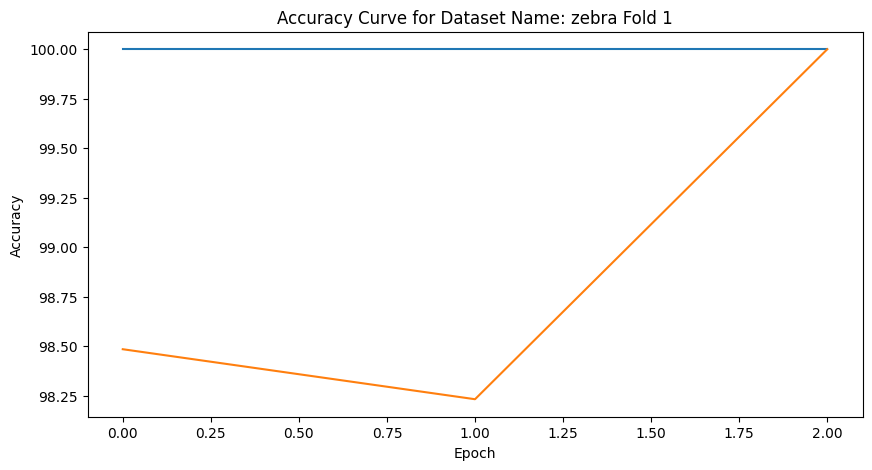

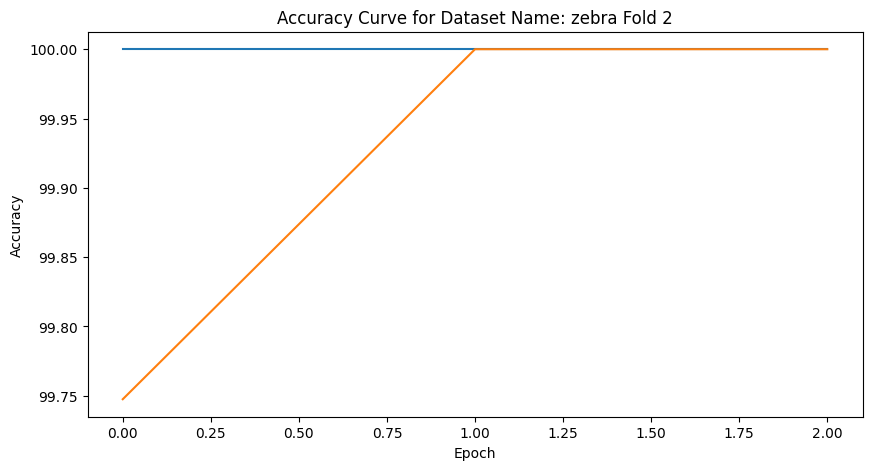

In [15]:

from efficientnet_pytorch import EfficientNet

class CEfficientNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.efficientnet = EfficientNet.from_pretrained('efficientnet-b0')
        self.fc = nn.Linear(1000, 2)

    def forward(self, x):
        x = self.efficientnet(x)
        x = self.fc(x)
        return x

model_EfficientNet = CEfficientNet()
run_label_classification_one_vs_rest_fold(model_EfficientNet, 'Effnet')

Model using MobileNet

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.

  warnings.warn(

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V2_Weights.DEFAULT` to get the most up-to-date weights.

  warnings.warn(msg)

Downloading: "https://download.pytorch.org/models/mobilenet_v2-b0353104.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-b0353104.pth

100%|██████████| 13.6M/13.6M [00:00<00:00, 88.3MB/s]


antelope

--------------------------------

FOLD 0

--------------------------------

Epoch: 1 	Training Loss: 0.449907 	Test Loss: 3.496867 	Train Accuracy 94.444444% 	Test Accuracy: 80.30%

Epoch: 2 	Training Loss: 0.057858 	Test Loss: 2.063887 	Train Accuracy 95.454545% 	Test Accuracy: 98.23%

Epoch: 3 	Training Loss: 0.022797 	Test Loss: 2.070962 	Train Accuracy 95.454545% 	Test Accuracy: 99.24%

Confusion Matrix for fold 0

[[178   1]

 [  8  11]]

FOLD 1

--------------------------------

Epoch: 1 	Training Loss: 0.082081 	Test Loss: 1.187017 	Train Accuracy 98.484848% 	Test Accuracy: 97.73%

Epoch: 2 	Training Loss: 0.009121 	Test Loss: 0.995837 	Train Accuracy 98.484848% 	Test Accuracy: 100.00%

Epoch: 3 	Training Loss: 0.005093 	Test Loss: 1.065584 	Train Accuracy 97.979798% 	Test Accuracy: 100.00%

Confusion Matrix for fold 1

[[171   3]

 [  1  23]]

FOLD 2

--------------------------------

Epoch: 1 	Training Loss: 0.063607 	Test Loss: 0.059494 	Train Accuracy 100.000000% 	

/tmp/ipykernel_25/2747969893.py:91: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.

  plt.figure(figsize=(10, 5))


--------------------------------

FOLD 0

--------------------------------

Epoch: 1 	Training Loss: 0.442320 	Test Loss: 4.481291 	Train Accuracy 96.969697% 	Test Accuracy: 91.67%

Epoch: 2 	Training Loss: 0.067436 	Test Loss: 2.998210 	Train Accuracy 96.969697% 	Test Accuracy: 97.98%

Epoch: 3 	Training Loss: 0.006476 	Test Loss: 2.398304 	Train Accuracy 97.474747% 	Test Accuracy: 100.00%

Confusion Matrix for fold 0

[[175   4]

 [  1  18]]

FOLD 1

--------------------------------

Epoch: 1 	Training Loss: 0.049407 	Test Loss: 0.155124 	Train Accuracy 100.000000% 	Test Accuracy: 97.73%

Epoch: 2 	Training Loss: 0.010888 	Test Loss: 0.138408 	Train Accuracy 100.000000% 	Test Accuracy: 100.00%

Epoch: 3 	Training Loss: 0.004064 	Test Loss: 0.062454 	Train Accuracy 100.000000% 	Test Accuracy: 100.00%

Confusion Matrix for fold 1

[[179   0]

 [  0  19]]

FOLD 2

--------------------------------

Epoch: 1 	Training Loss: 0.003281 	Test Loss: 0.024137 	Train Accuracy 100.000000% 	Test A

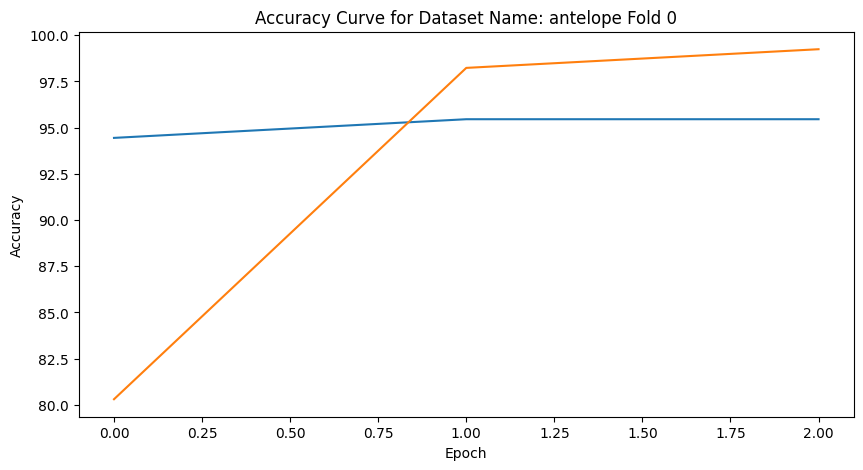

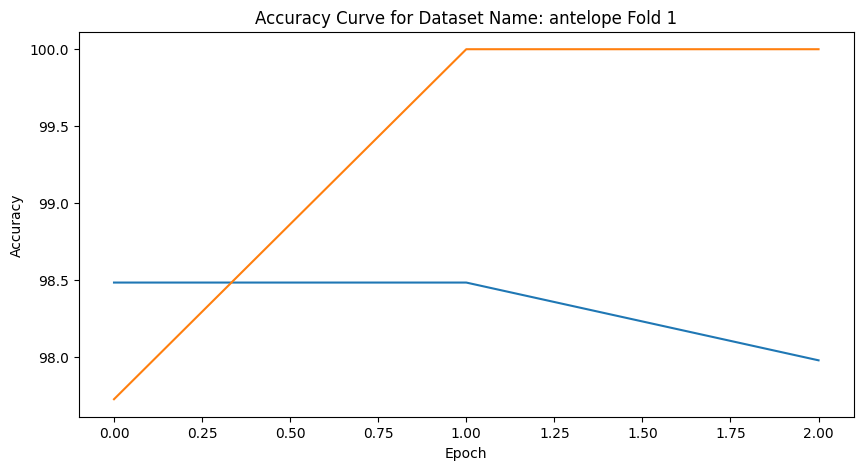

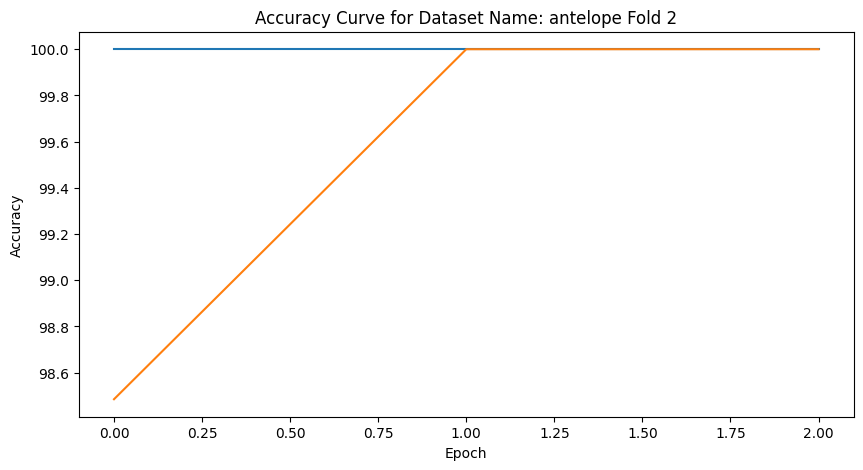

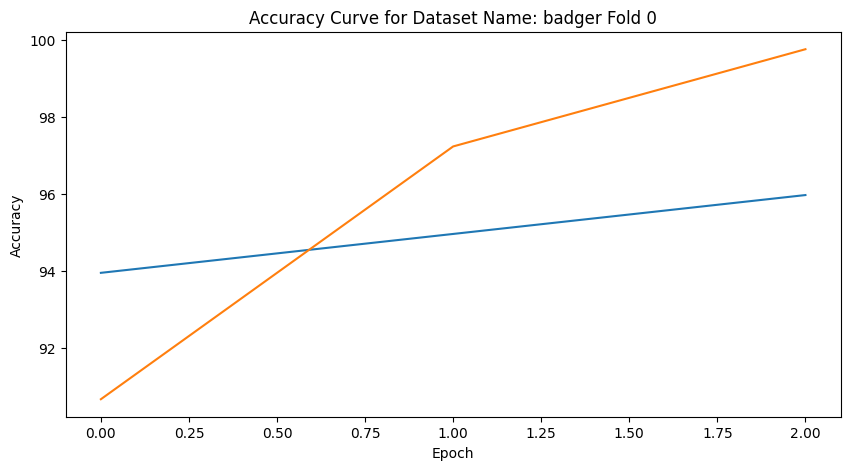

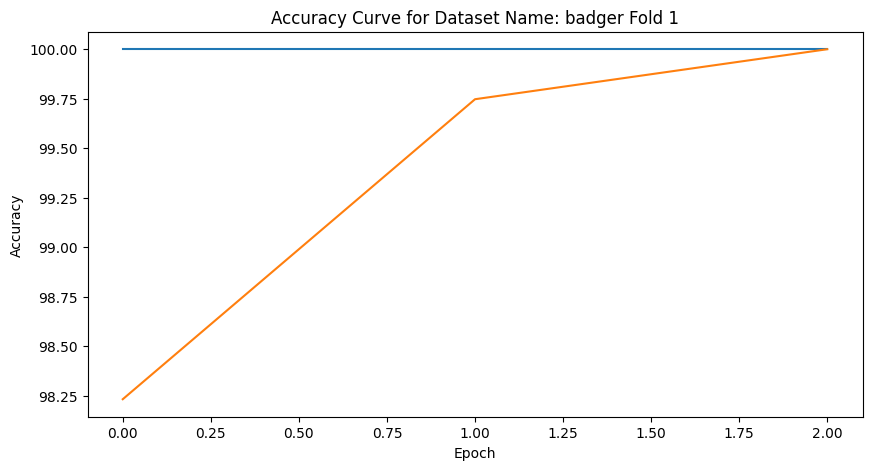

...

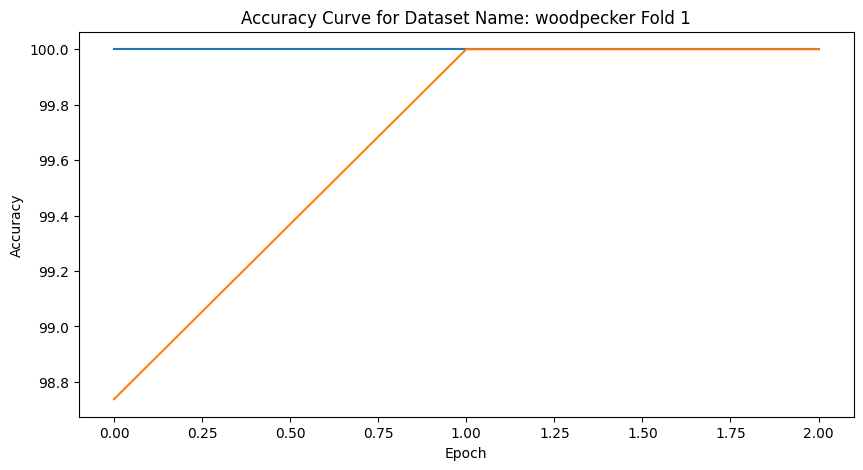

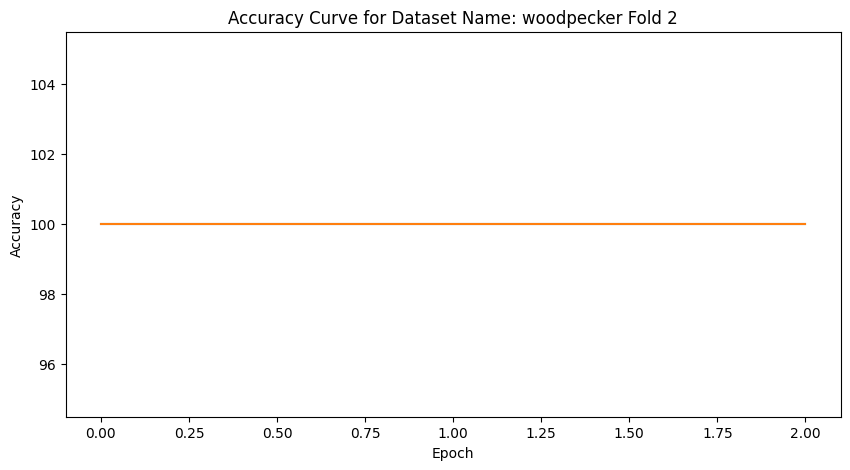

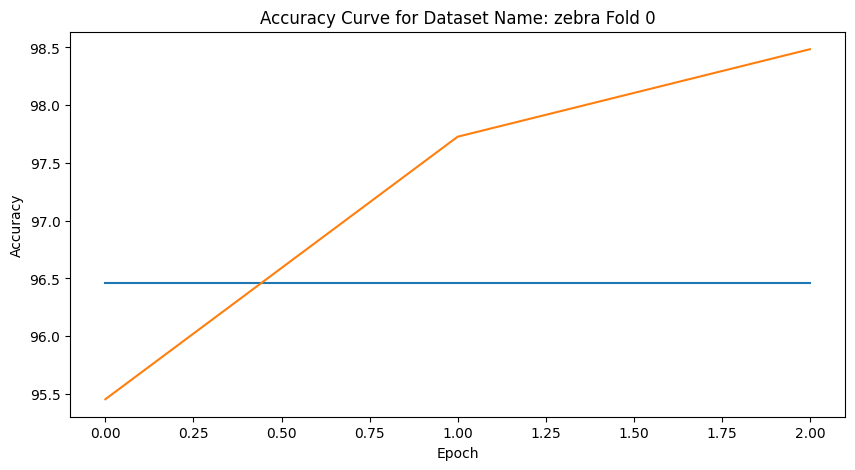

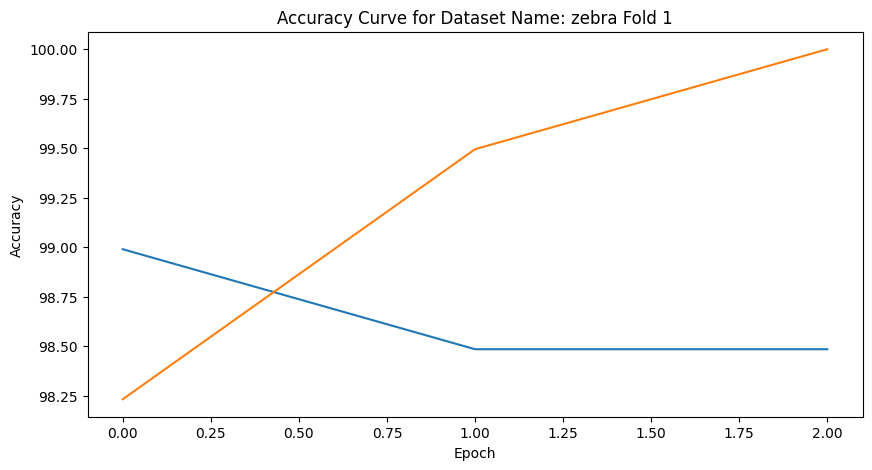

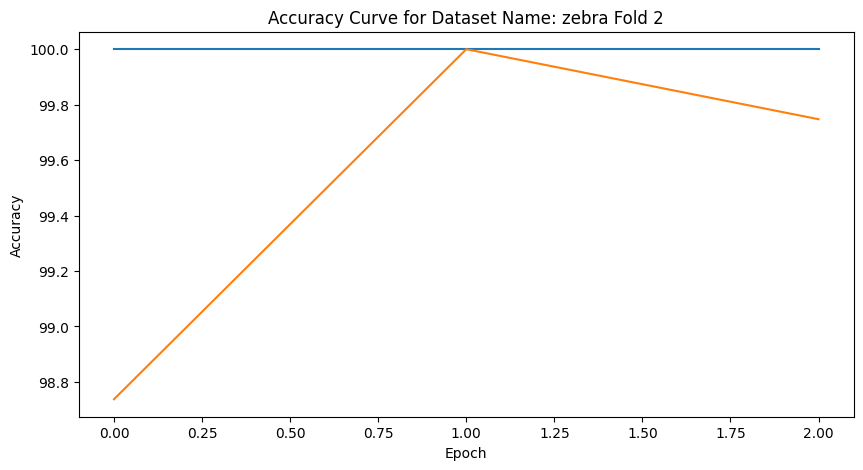

In [16]:

from torchvision import models

class CMobileNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.mobilenet = models.mobilenet_v2(pretrained=True)
        self.fc = nn.Linear(1000, 2)

    def forward(self, x):
        x = self.mobilenet(x)
        x = self.fc(x)
        return x
    
model_MobileNet = CMobileNet()
run_label_classification_one_vs_rest_fold(model_MobileNet, 'Mobilenet')

Model using CustomNet

antelope

--------------------------------

FOLD 0

--------------------------------

Epoch: 1 	Training Loss: 0.669620 	Test Loss: 8.974802 	Train Accuracy 92.929293% 	Test Accuracy: 82.07%

Epoch: 2 	Training Loss: 0.361393 	Test Loss: 6.040587 	Train Accuracy 92.929293% 	Test Accuracy: 88.38%

Epoch: 3 	Training Loss: 0.273055 	Test Loss: 7.406120 	Train Accuracy 90.909091% 	Test Accuracy: 88.38%

Confusion Matrix for fold 0

[[175   9]

 [  9   5]]

FOLD 1

--------------------------------

Epoch: 1 	Training Loss: 0.254683 	Test Loss: 8.232223 	Train Accuracy 89.393939% 	Test Accuracy: 92.17%

Epoch: 2 	Training Loss: 0.187803 	Test Loss: 7.314911 	Train Accuracy 91.414141% 	Test Accuracy: 92.17%

Epoch: 3 	Training Loss: 0.150393 	Test Loss: 7.886120 	Train Accuracy 90.909091% 	Test Accuracy: 94.95%

Confusion Matrix for fold 1

[[177   0]

 [ 18   3]]

FOLD 2

--------------------------------

Epoch: 1 	Training Loss: 0.190046 	Test Loss: 2.947219 	Train Accuracy 94.949495% 	Tes

/tmp/ipykernel_25/2747969893.py:91: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.

  plt.figure(figsize=(10, 5))


--------------------------------

FOLD 0

--------------------------------

Epoch: 1 	Training Loss: 0.472053 	Test Loss: 3.319757 	Train Accuracy 97.474747% 	Test Accuracy: 90.15%

Epoch: 2 	Training Loss: 0.188189 	Test Loss: 2.985494 	Train Accuracy 97.474747% 	Test Accuracy: 94.70%

Epoch: 3 	Training Loss: 0.103561 	Test Loss: 2.458714 	Train Accuracy 95.959596% 	Test Accuracy: 96.46%

Confusion Matrix for fold 0

[[180   2]

 [  6  10]]

FOLD 1

--------------------------------

Epoch: 1 	Training Loss: 0.144386 	Test Loss: 3.757250 	Train Accuracy 95.454545% 	Test Accuracy: 95.96%

Epoch: 2 	Training Loss: 0.044620 	Test Loss: 5.051446 	Train Accuracy 94.949495% 	Test Accuracy: 98.23%

Epoch: 3 	Training Loss: 0.041378 	Test Loss: 2.950866 	Train Accuracy 96.969697% 	Test Accuracy: 98.48%

Confusion Matrix for fold 1

[[171   2]

 [  4  21]]

FOLD 2

--------------------------------

Epoch: 1 	Training Loss: 0.107517 	Test Loss: 1.112651 	Train Accuracy 99.494949% 	Test Accuracy

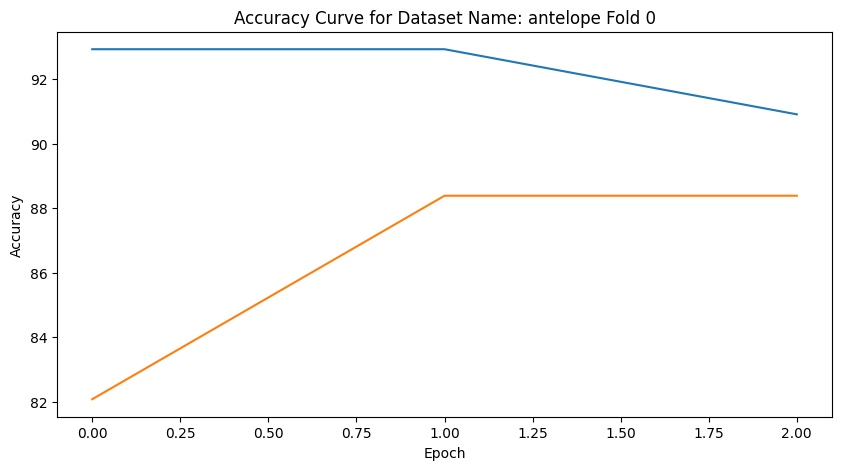

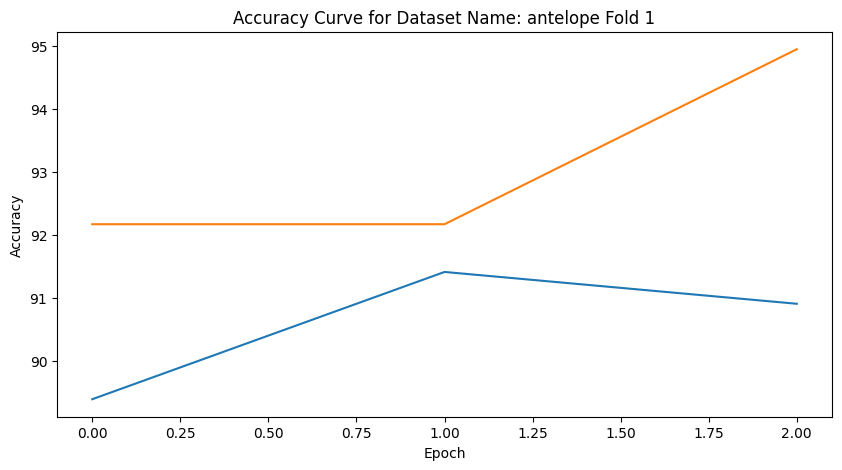

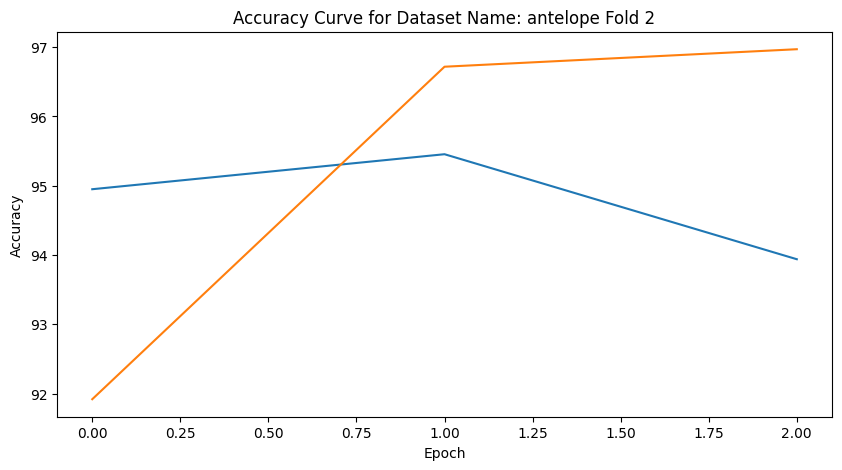

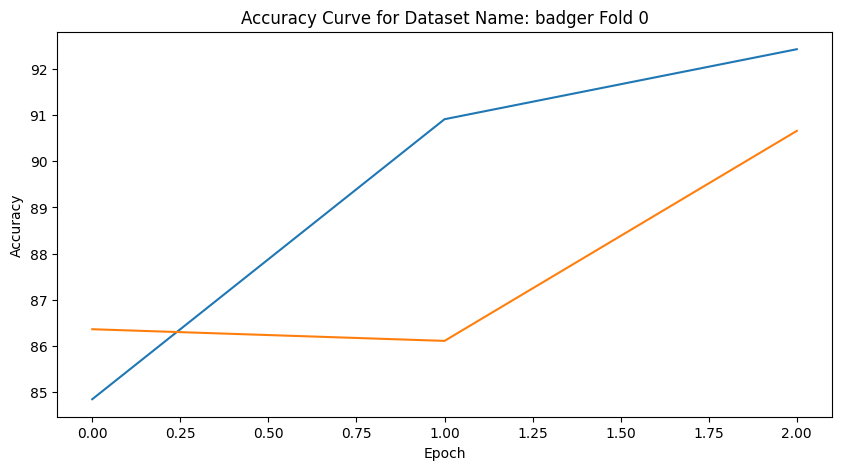

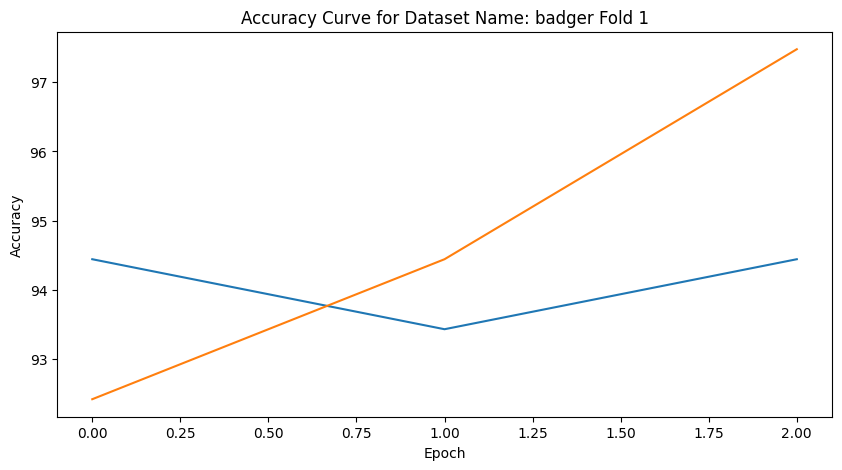

...

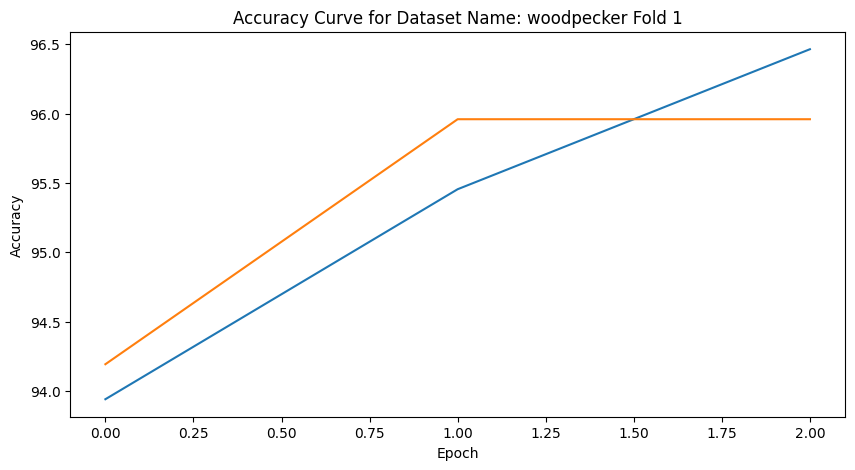

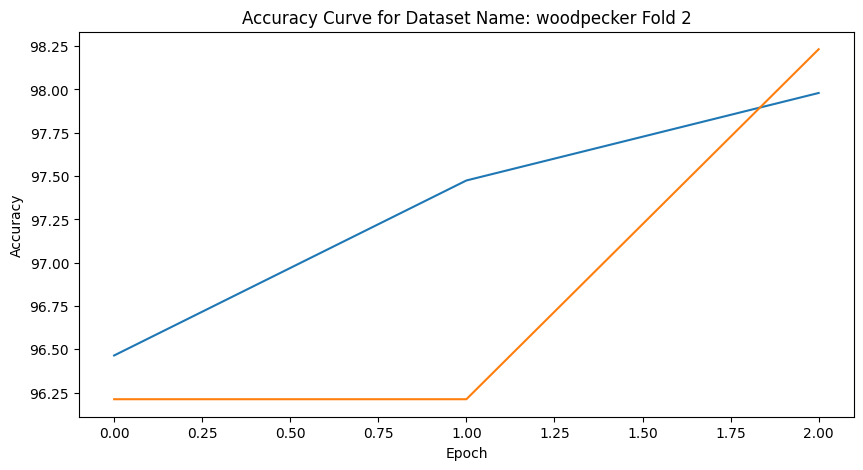

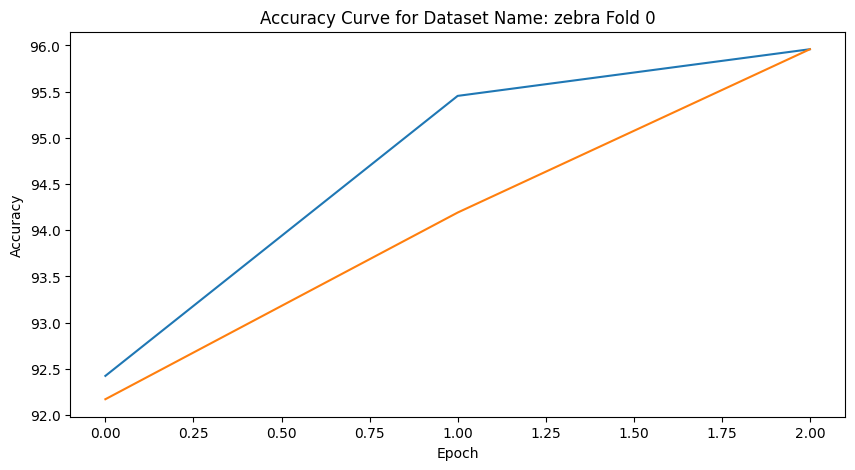

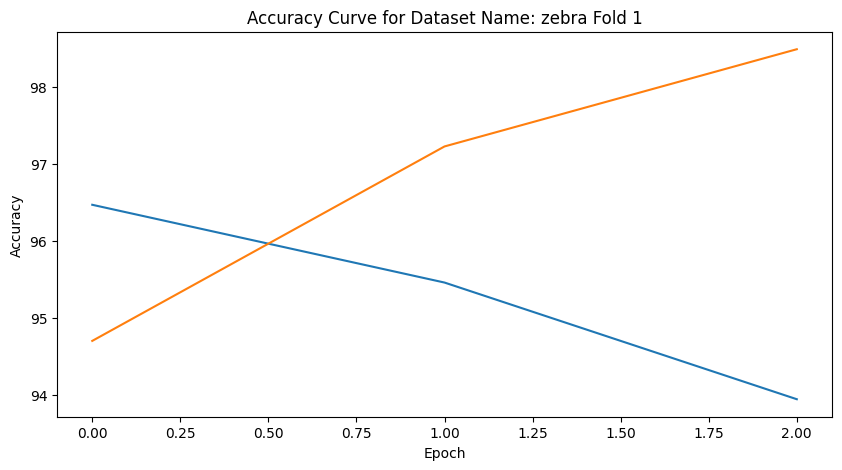

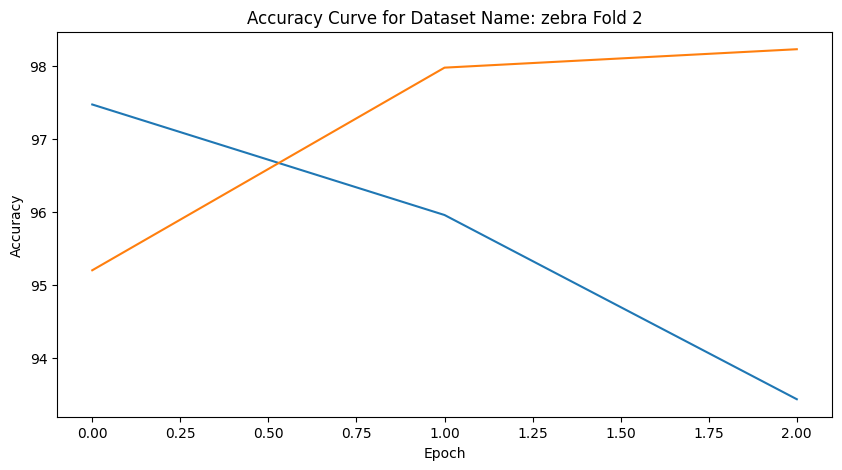

In [17]:

class Attention(nn.Module):
    def __init__(self, in_features):
        super().__init__()
        self.attention = nn.Sequential(
            nn.Linear(in_features, in_features),
            nn.Tanh(),
            nn.Linear(in_features, 1),
            nn.Softmax(dim=1)
        )

    def forward(self, x):
        attention_weights = self.attention(x)
        return attention_weights * x

class CustomCNN(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.fc1 = nn.Linear(64*56*56, 1000) 
        self.attention = Attention(1000)
        self.fc2 = nn.Linear(1000, 2)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.max_pool2d(x, 2)
        x = F.relu(self.conv2(x))
        x = F.max_pool2d(x, 2)
        x = x.view(x.size(0), -1) 
        x = F.relu(self.fc1(x))
        x = self.attention(x)
        x = self.fc2(x)
        return x

model_CustomCNN = CustomCNN()
run_label_classification_one_vs_rest_fold(model_CustomCNN, 'CustomCNN')

# 5 Class Classification using 3 Fold CV

In [18]:
path = "/kaggle/input/animal-image-dataset-90-different-animals/animals/animals"

In [19]:
class dataset_pent_class(torch.utils.data.Dataset):
    def __init__(self,start_idx, path=path, window_size= 5):
        super().__init__()
        classes = os.listdir(path)
        self.images = []
        self.labels = []
        self.transforms = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
            ])
        end_idx = start_idx*5 + window_size
        for i in range(start_idx*5, end_idx):
            folder_name = classes[i] 
            anim_fold = os.path.join(path, folder_name)
            for localpath in os.listdir(anim_fold):
                img_path = os.path.join(anim_fold, localpath)
                self.images.append(img_path)
                self.labels.append(i % window_size)  
        
    def __len__(self):
        return len(self.images)
    def __getitem__(self,idx):
        img = Image.open(self.images[idx])
        label = self.labels[idx]
        return self.transforms(img), torch.tensor(label, dtype=torch.long)
      

```run_label_classification_one_vs_rest_fold``` even though the method name is the same, this takes multiple inputs, and saves the model weights. These weights are then loaded to visualise the model view images after the full process.

In [20]:
def run_label_classification_one_vs_rest_fold(model_net, name, start_idx=0, window_size=5):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    name_model = str(name)
    for i in range(start_idx, 17, window_size):
        print(i, "structure folder")
        dataset = dataset_pent_class(i, window_size=window_size)

        kfold = KFold(n_splits=3, shuffle=True)

        print('--------------------------------')

        for fold, (train_ids, test_ids) in enumerate(kfold.split(dataset)):

            print(f'FOLD {fold}')
            print('--------------------------------')

            train_subsampler = torch.utils.data.SubsetRandomSampler(train_ids)
            test_subsampler = torch.utils.data.SubsetRandomSampler(test_ids)

            train_loader = DataLoader(dataset, batch_size=32, sampler=train_subsampler, pin_memory=True, num_workers=2)
            test_loader = DataLoader(dataset, batch_size=32, sampler=test_subsampler, pin_memory=True, num_workers=2)

            model = model_net
            model.to(device)

            optimizer = optim.Adam(model.parameters(), lr=5e-5)
            train_losses = []
            test_losses = []
            train_accuracies = []
            test_accuracies = []

            for epoch in range(3):

                model.train()
                correct = 0
                total = 0
                train_loss = 0.0
                for _, (inputs, labels) in enumerate(train_loader):
                    inputs, labels = inputs.to(device), labels.to(device)
                    optimizer.zero_grad()

                    outputs = model(inputs)
                    loss = nn.CrossEntropyLoss()(outputs, labels)
                    loss.backward()
                    optimizer.step()
                    train_loss += loss.item()
                    _, predicted = outputs.max(1)
                    total += labels.size(0)
                    correct += predicted.eq(labels).sum().item()

                model.eval()  
                test_loss = 0.0
                test_correct = 0
                test_total = 0
                all_labels = []
                all_predictions = []

                for inputs, labels in test_loader:
                    inputs, labels = inputs.to(device), labels.to(device)
                    outputs = model(inputs)
                    loss = nn.CrossEntropyLoss()(outputs, labels)
                    test_loss += loss.item()*inputs.size(0)
                    _, predicted = outputs.max(1)
                    test_total += labels.size(0)
                    test_correct += predicted.eq(labels).sum().item()
                    all_labels.extend(labels.cpu().numpy())
                    all_predictions.extend(predicted.cpu().numpy())


                test_loss = test_loss / len(test_loader)
                train_loss = train_loss/len(train_loader)
                test_accuracy = 100.0 * correct / total
                train_accuracy = 100.0 * test_correct/test_total

                train_losses.append(train_loss)
                test_losses.append(test_loss)
                train_accuracies.append(train_accuracy)
                test_accuracies.append(test_accuracy)

                print('Epoch: {} \tTraining Loss: {:.6f} \tTest Loss: {:.6f} \tTrain Accuracy {:.6f}% \tTest Accuracy: {:.2f}%'.format(
                    epoch+1, 
                    train_loss,
                    test_loss,
                    train_accuracy,
                    test_accuracy
                    ))
                
            directory = f'/kaggle/working/5fold/{i}/{fold}/'
            os.makedirs(directory, exist_ok=True)

            plt.figure(figsize=(10, 5))
            plt.plot(train_accuracies, label='Train Accuracy')
            plt.plot(test_accuracies, label='Test Accuracy')
            plt.title('Accuracy Curve for {} Dataset, Fold {}'.format(i, fold))
            plt.xlabel('Epoch')
            plt.ylabel('Accuracy')
            plt.savefig(os.path.join(directory, f'{fold}.png'))
            
            model_directory = f'/kaggle/working/5fold_model/'
            os.makedirs(model_directory, exist_ok=True)
            torch.save(model.state_dict(), os.path.join(model_directory, f'{name_model}.pth'))


            print('Confusion Matrix for fold {}'.format(fold))
            print(confusion_matrix(all_labels, all_predictions))


EfficientNet b0


In [21]:
!pip install efficientnet_pytorch

Loaded pretrained weights for efficientnet-b0

0 structure folder

--------------------------------

FOLD 0

--------------------------------

Epoch: 1 	Training Loss: 1.476082 	Test Loss: 33.562795 	Train Accuracy 47.000000% 	Test Accuracy: 33.00%

Epoch: 2 	Training Loss: 0.948923 	Test Loss: 24.719739 	Train Accuracy 75.000000% 	Test Accuracy: 78.50%

Epoch: 3 	Training Loss: 0.672210 	Test Loss: 17.670963 	Train Accuracy 94.000000% 	Test Accuracy: 90.50%

Confusion Matrix for fold 0

[[20  0  0  0  0]

 [ 1 22  1  0  1]

 [ 0  0 23  0  0]

 [ 0  0  1 12  0]

 [ 0  0  2  0 17]]

FOLD 1

--------------------------------

Epoch: 1 	Training Loss: 0.501117 	Test Loss: 10.992552 	Train Accuracy 94.000000% 	Test Accuracy: 94.00%

Epoch: 2 	Training Loss: 0.291411 	Test Loss: 7.837143 	Train Accuracy 95.000000% 	Test Accuracy: 98.00%

Epoch: 3 	Training Loss: 0.186799 	Test Loss: 5.500484 	Train Accuracy 97.000000% 	Test Accuracy: 99.50%

Confusion Matrix for fold 1

[[16  0  0  0  0]

 [

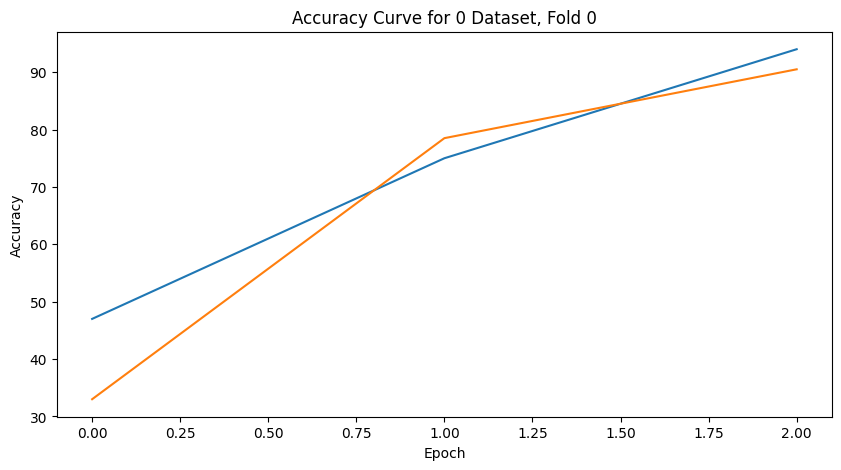

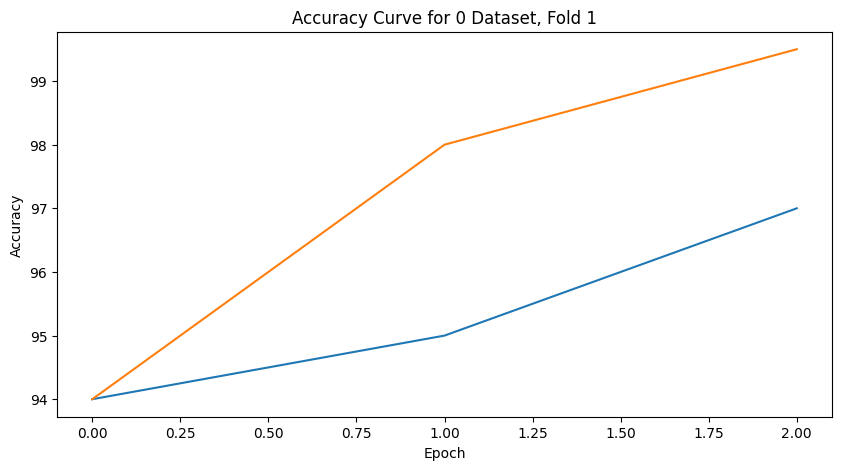

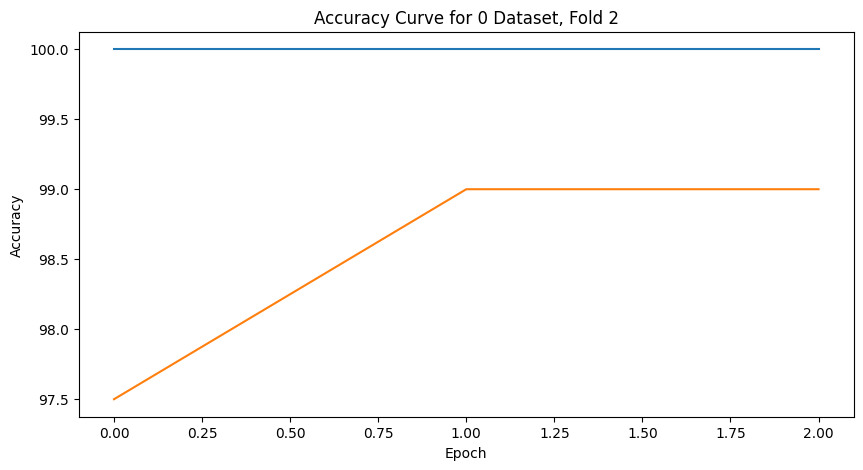

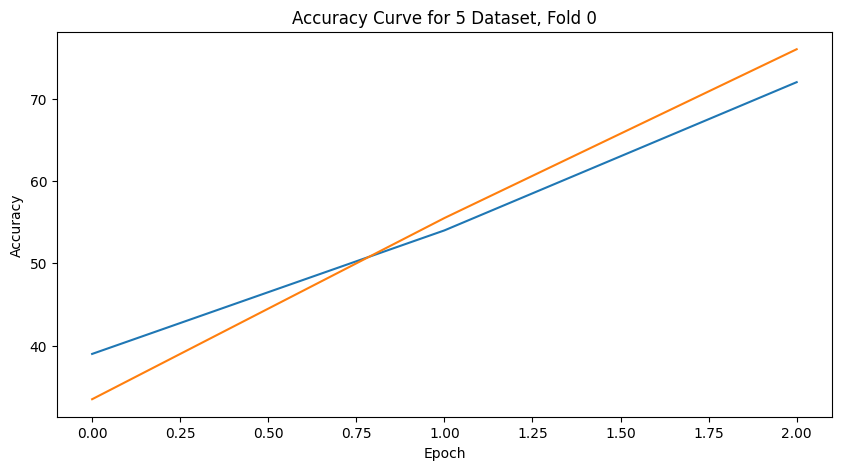

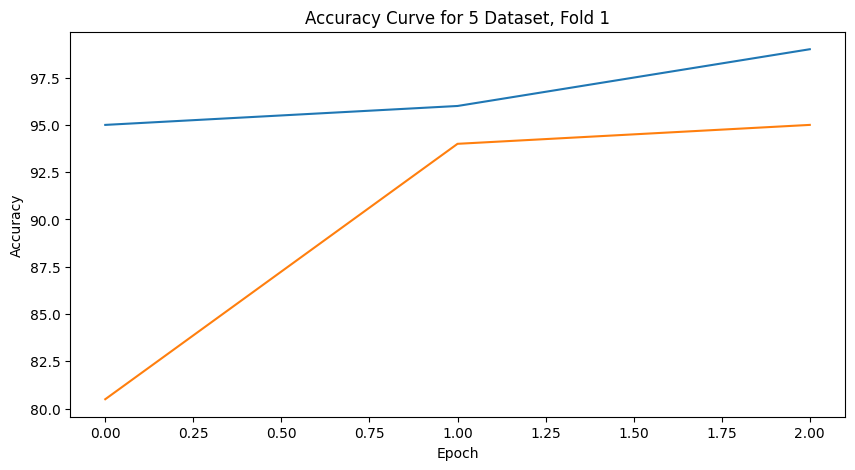

...

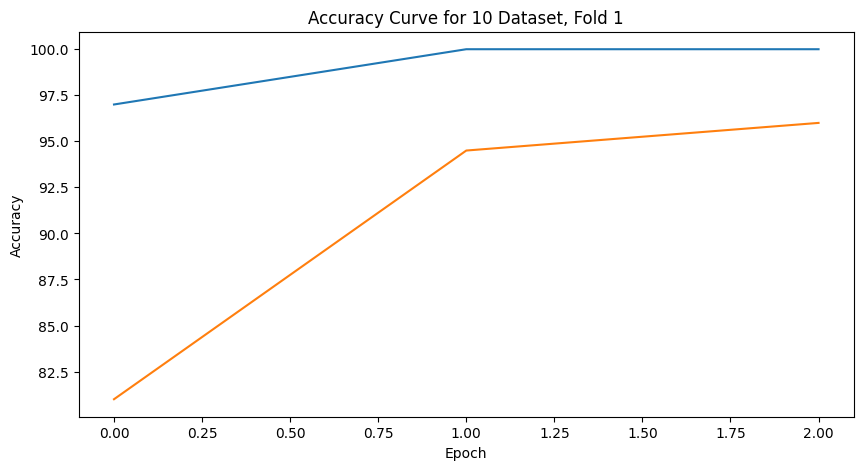

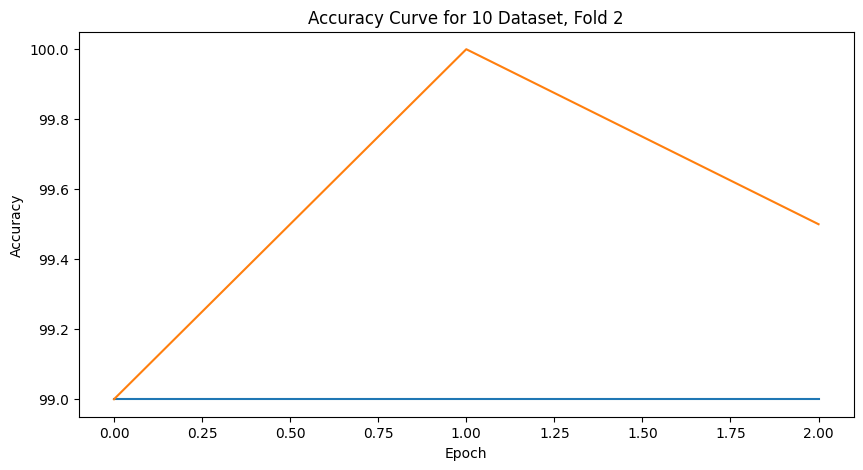

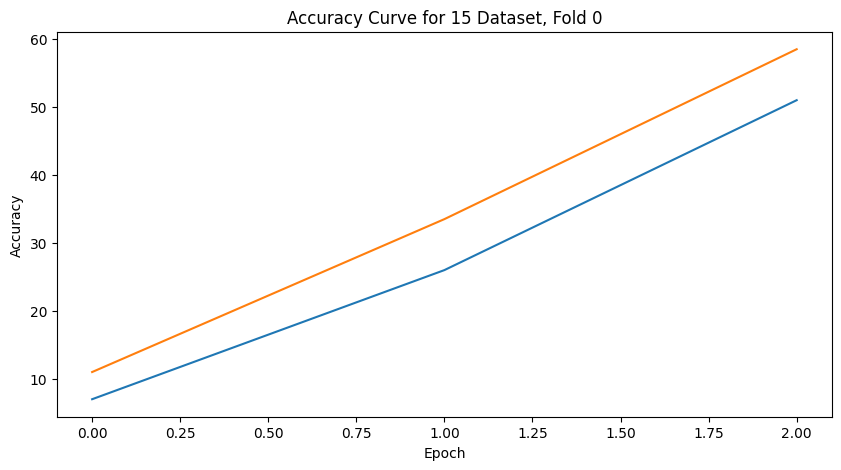

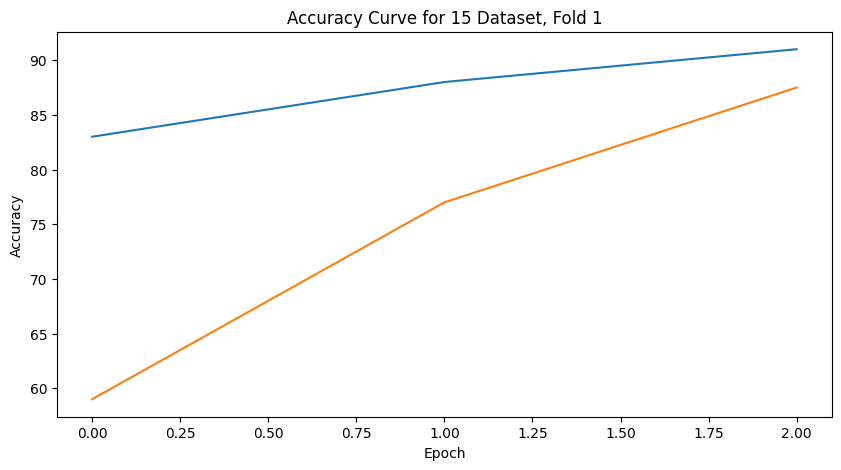

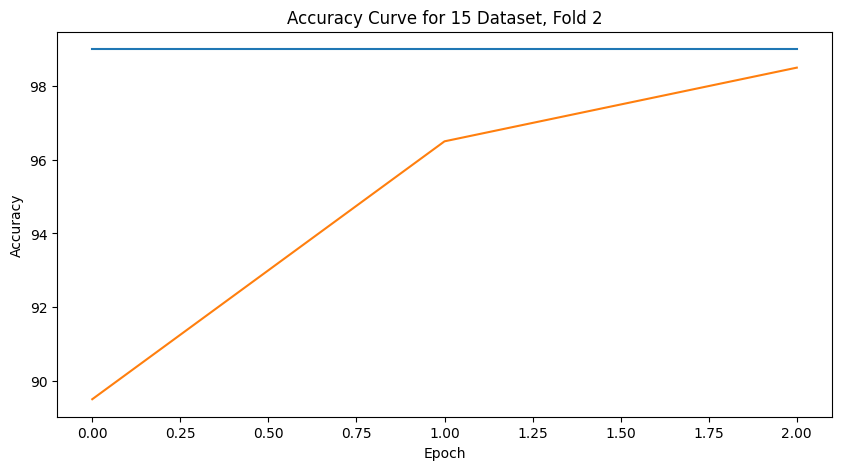

In [22]:

from efficientnet_pytorch import EfficientNet

class CEfficientNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.efficientnet = EfficientNet.from_pretrained('efficientnet-b0')
        self.fc = nn.Linear(1000, 5)

    def forward(self, x):
        x = self.efficientnet(x)
        x = self.fc(x)
        return x

model_EfficientNet = CEfficientNet()
run_label_classification_one_vs_rest_fold(model_EfficientNet, 'EffNet', 0, 5)

MobileNet

0 structure folder

--------------------------------

FOLD 0

--------------------------------


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.

  warnings.warn(

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V2_Weights.DEFAULT` to get the most up-to-date weights.

  warnings.warn(msg)


Epoch: 1 	Training Loss: 1.179964 	Test Loss: 9.777699 	Train Accuracy 93.000000% 	Test Accuracy: 52.00%

Epoch: 2 	Training Loss: 0.182068 	Test Loss: 2.766573 	Train Accuracy 99.000000% 	Test Accuracy: 96.00%

Epoch: 3 	Training Loss: 0.099245 	Test Loss: 1.588143 	Train Accuracy 98.000000% 	Test Accuracy: 98.50%

Confusion Matrix for fold 0

[[29  0  0  0  0]

 [ 0 16  0  0  0]

 [ 0  0 21  1  0]

 [ 0  0  1 18  0]

 [ 0  0  0  0 14]]

FOLD 1

--------------------------------

Epoch: 1 	Training Loss: 0.078987 	Test Loss: 0.258029 	Train Accuracy 100.000000% 	Test Accuracy: 97.50%

Epoch: 2 	Training Loss: 0.025035 	Test Loss: 0.263087 	Train Accuracy 100.000000% 	Test Accuracy: 99.50%

Epoch: 3 	Training Loss: 0.014091 	Test Loss: 0.218556 	Train Accuracy 100.000000% 	Test Accuracy: 100.00%

Confusion Matrix for fold 1

[[12  0  0  0  0]

 [ 0 21  0  0  0]

 [ 0  0 17  0  0]

 [ 0  0  0 24  0]

 [ 0  0  0  0 26]]

FOLD 2

--------------------------------

Epoch: 1 	Training Loss: 0

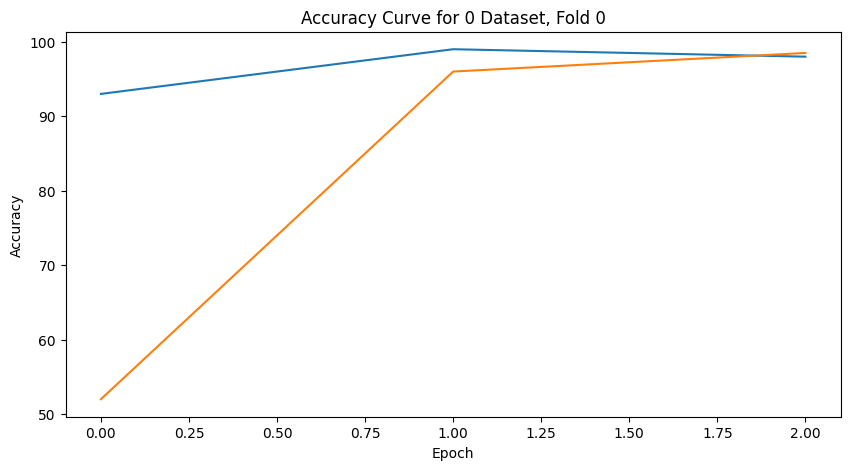

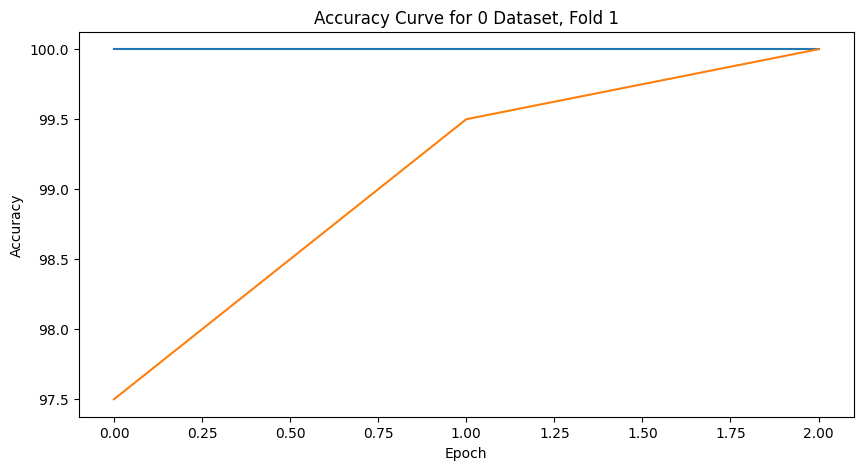

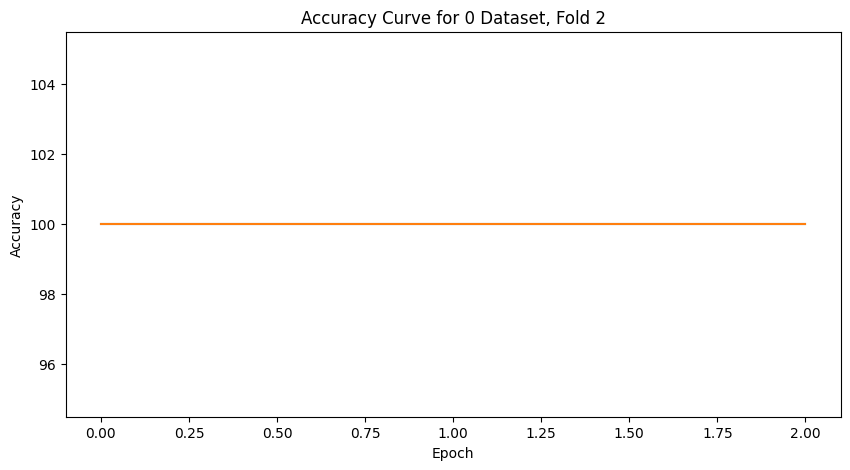

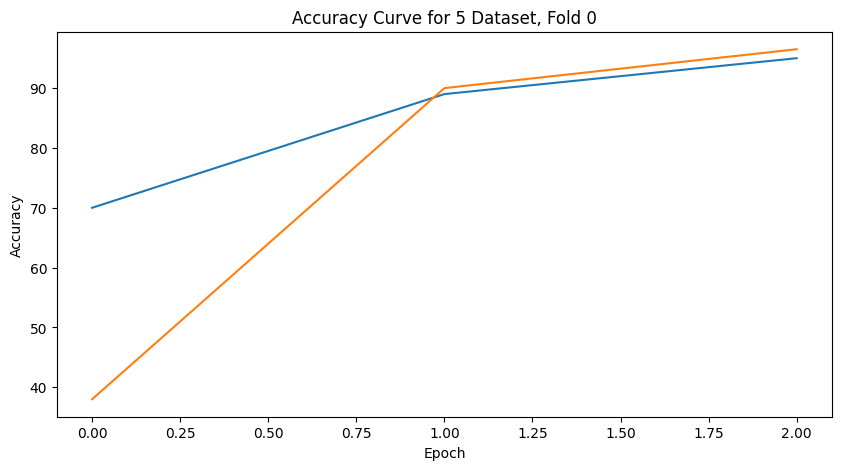

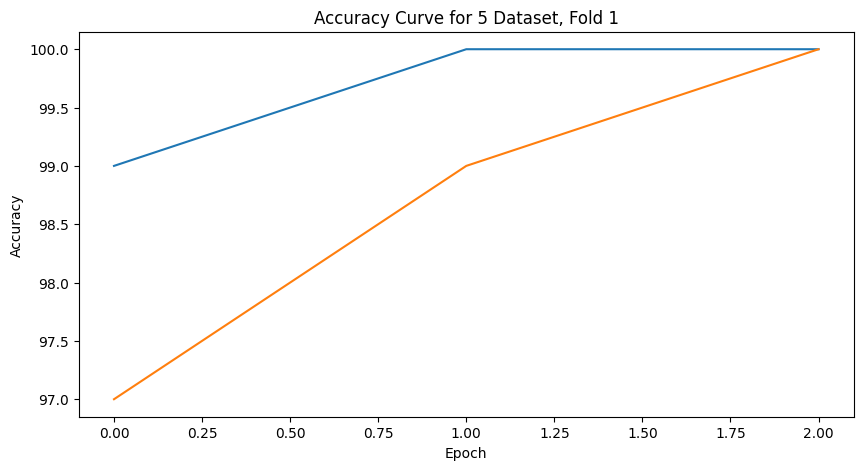

...

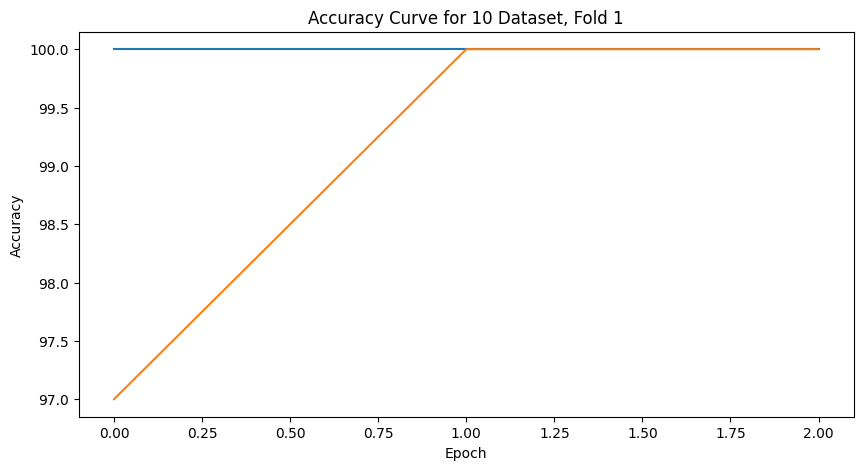

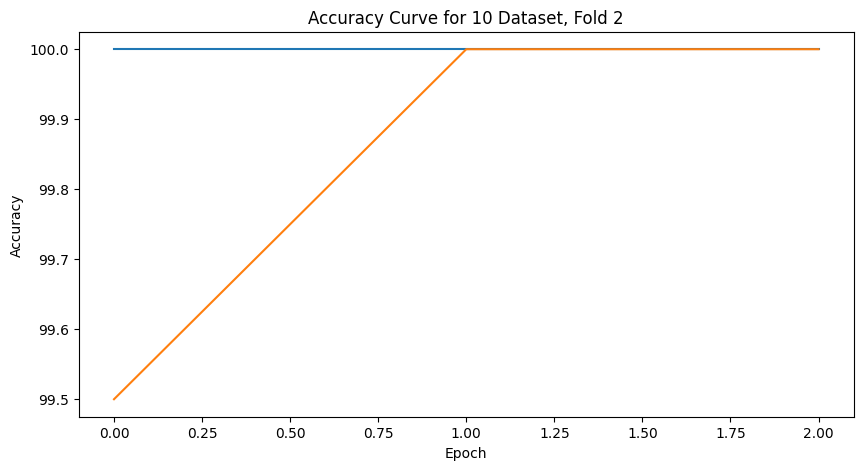

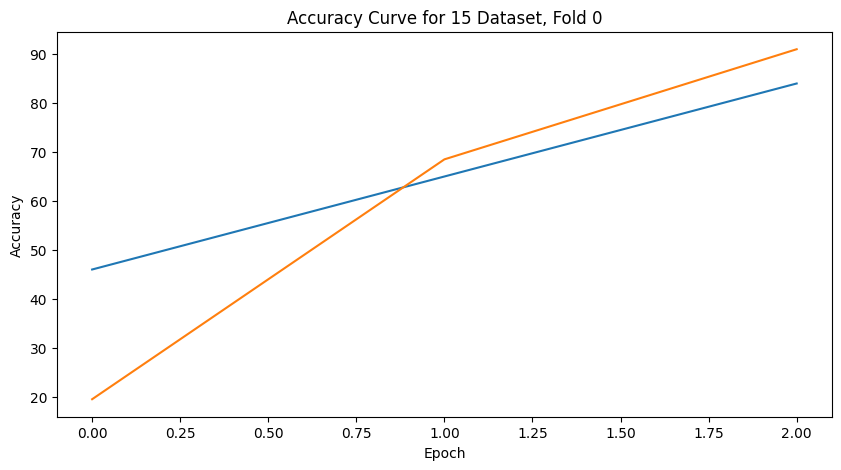

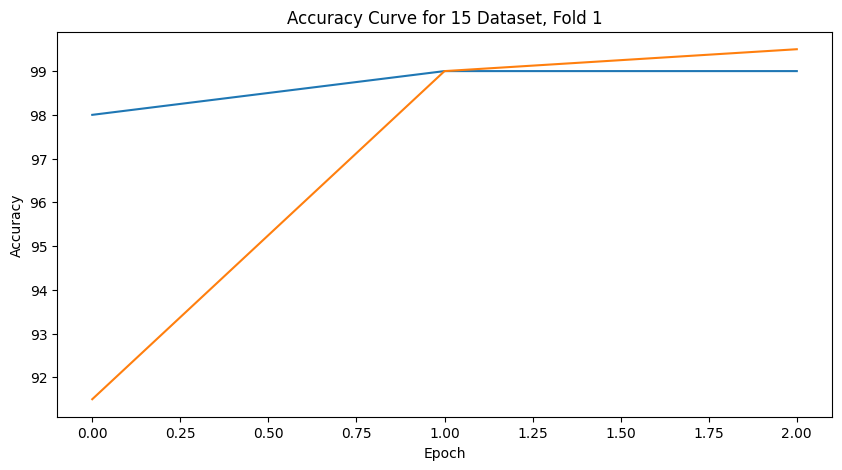

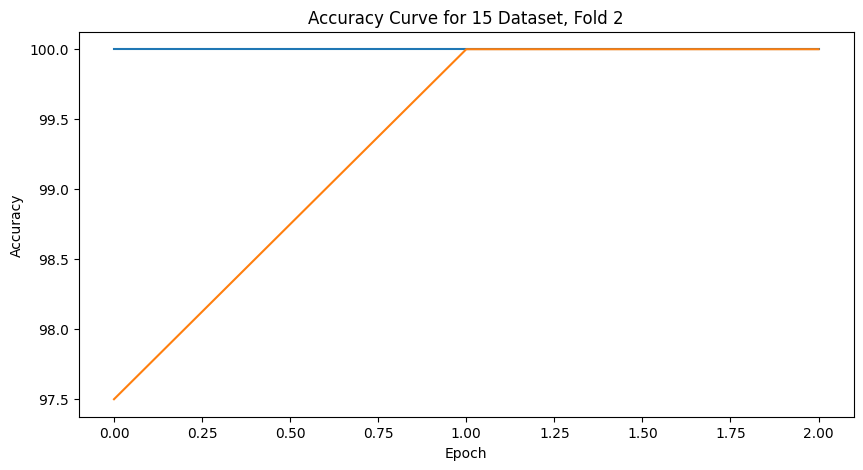

In [23]:

from torchvision import models

class CMobileNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.mobilenet = models.mobilenet_v2(pretrained=True)
        self.fc = nn.Linear(1000, 5)

    def forward(self, x):
        x = self.mobilenet(x)
        x = self.fc(x)
        return x
    
model_MobileNet = CMobileNet()
run_label_classification_one_vs_rest_fold(model_MobileNet, 'MobileNet', 0, 5)

Custom NeuralNetwork

0 structure folder

--------------------------------

FOLD 0

--------------------------------

Epoch: 1 	Training Loss: 2.384570 	Test Loss: 52.252406 	Train Accuracy 21.000000% 	Test Accuracy: 20.50%

Epoch: 2 	Training Loss: 1.624539 	Test Loss: 35.230742 	Train Accuracy 41.000000% 	Test Accuracy: 35.50%

Epoch: 3 	Training Loss: 1.177734 	Test Loss: 34.480355 	Train Accuracy 41.000000% 	Test Accuracy: 53.50%

Confusion Matrix for fold 0

[[15  0  0  2  1]

 [13  8  0  5  2]

 [ 6  1  1  4  7]

 [ 2  0  0  9  2]

 [ 9  0  0  5  8]]

FOLD 1

--------------------------------

Epoch: 1 	Training Loss: 1.257204 	Test Loss: 28.397870 	Train Accuracy 50.000000% 	Test Accuracy: 40.00%

Epoch: 2 	Training Loss: 1.028306 	Test Loss: 23.927473 	Train Accuracy 70.000000% 	Test Accuracy: 57.50%

Epoch: 3 	Training Loss: 0.713924 	Test Loss: 25.133063 	Train Accuracy 58.000000% 	Test Accuracy: 73.50%

Confusion Matrix for fold 1

[[12  6  1  2  1]

 [ 0 14  0  0  0]

 [ 1  5 10  2  0]

 [ 1  3  

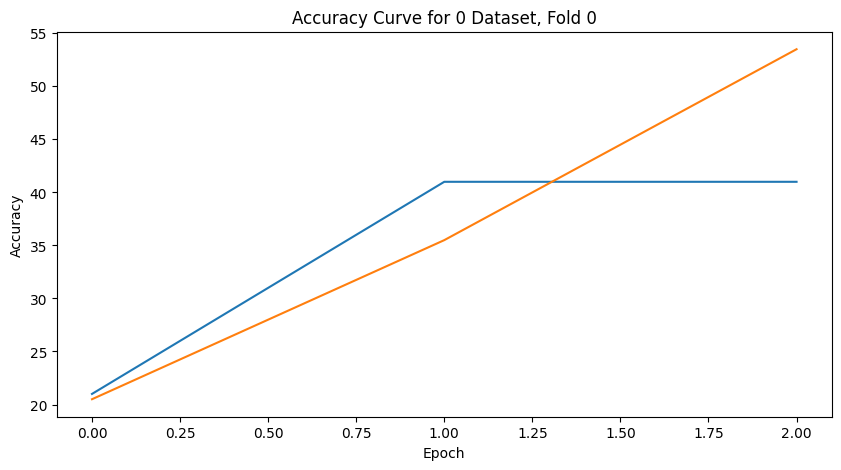

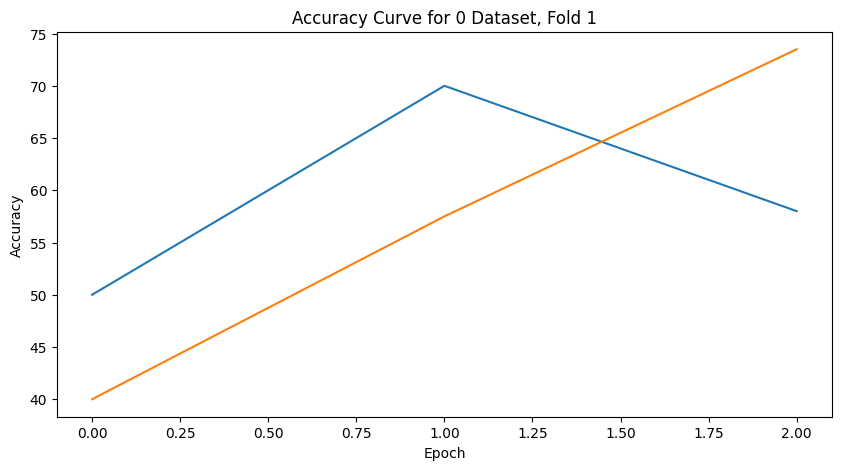

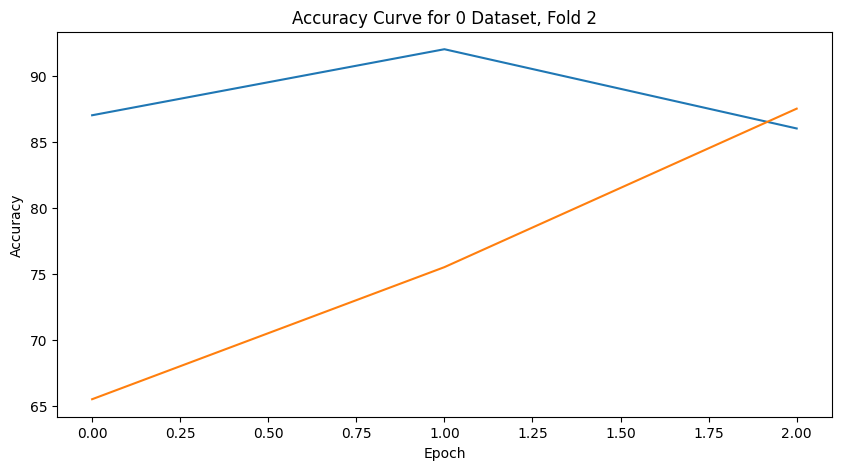

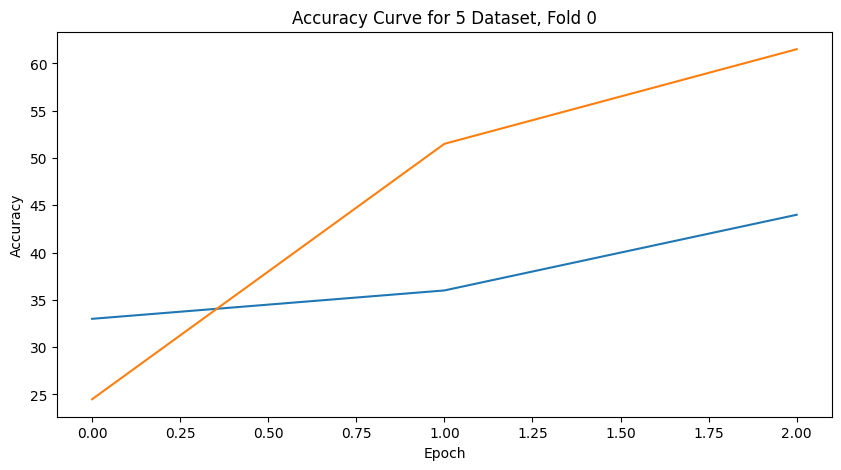

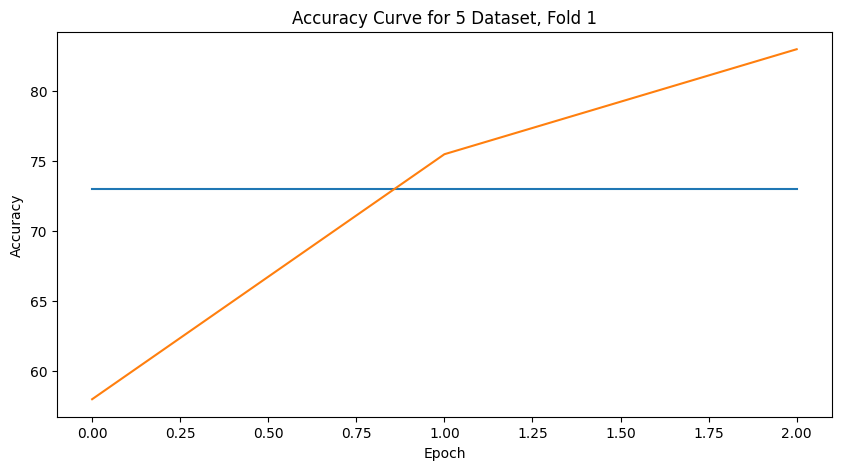

...

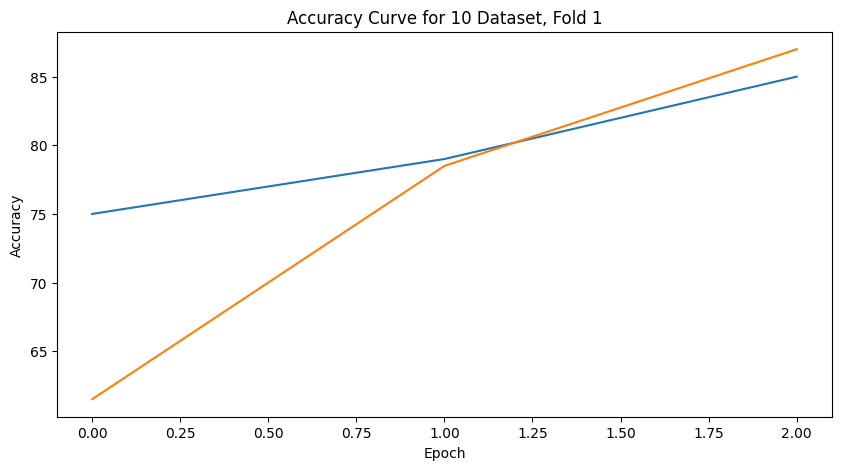

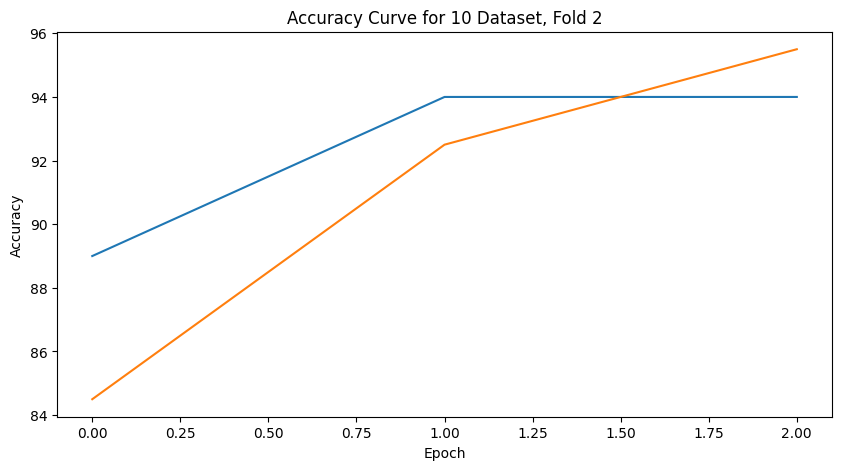

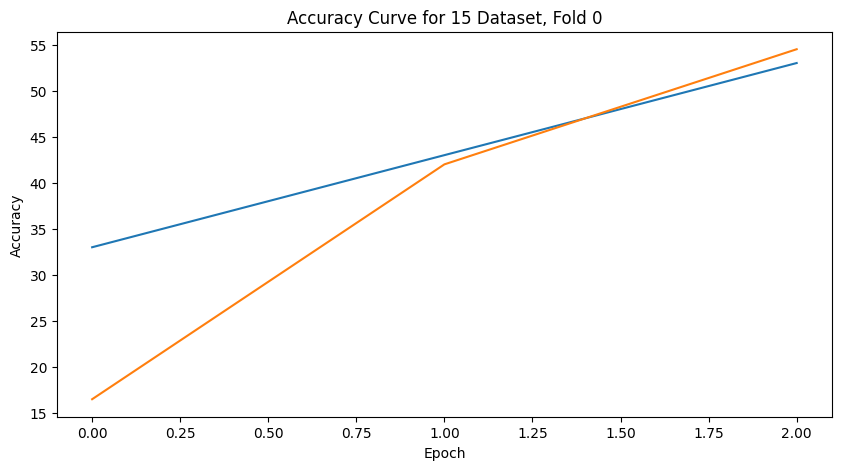

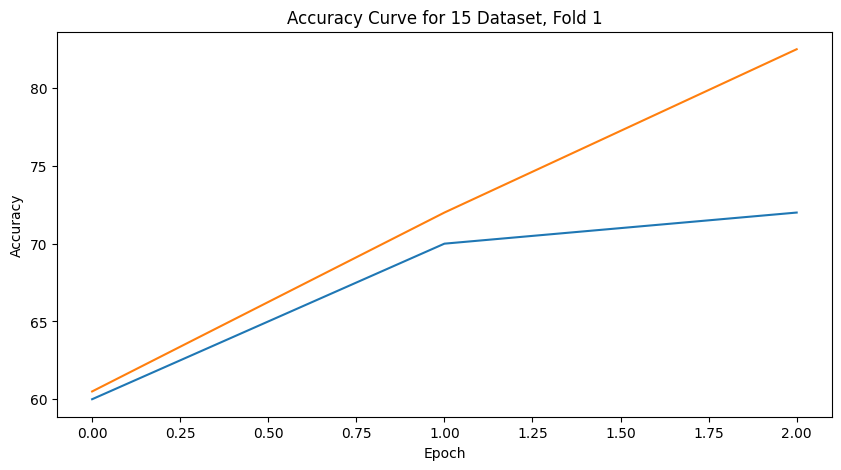

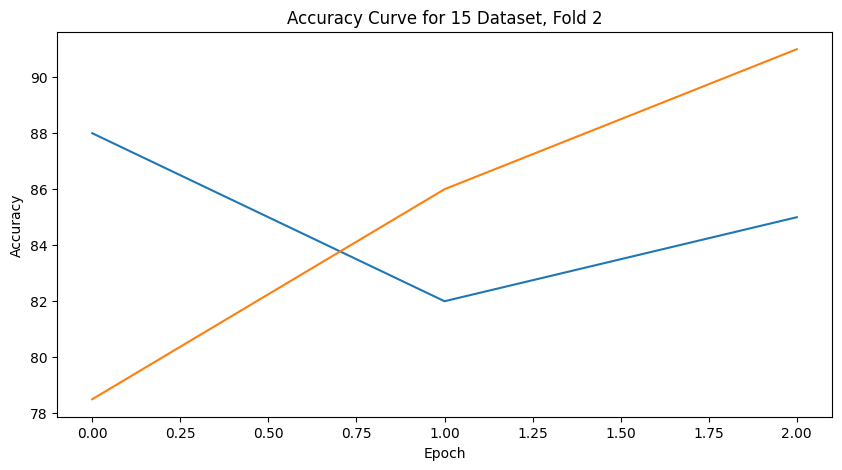

In [24]:


class Attention(nn.Module):
    def __init__(self, in_features):
        super().__init__()
        self.attention = nn.Sequential(
            nn.Linear(in_features, in_features),
            nn.Tanh(),
            nn.Linear(in_features, 1),
            nn.Softmax(dim=1)
        )

    def forward(self, x):
        attention_weights = self.attention(x)
        return attention_weights * x
    
class CustomCNN(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.fc1 = nn.Linear(64*56*56, 1000) 
        self.attention = Attention(1000)
        self.fc2 = nn.Linear(1000, 5) 

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.max_pool2d(x, 2)
        x = F.relu(self.conv2(x))
        x = F.max_pool2d(x, 2)
        x = x.view(x.size(0), -1) 
        x = F.relu(self.fc1(x))
        x = self.attention(x)
        x = self.fc2(x)
        return x

model_CustomCNN = CustomCNN()
run_label_classification_one_vs_rest_fold(model_CustomCNN, 'CustomCNN', 0, 5)

# Model Visualisation 

In [25]:
import torchvision
from torchvision import models, transforms, utils
from torch.autograd import Variable
import scipy.misc
import json

In [26]:
%matplotlib inline

Using the same transform as used during dataloading

Plotting the output of all convolutional layers and discuss the insights on automatically created features.

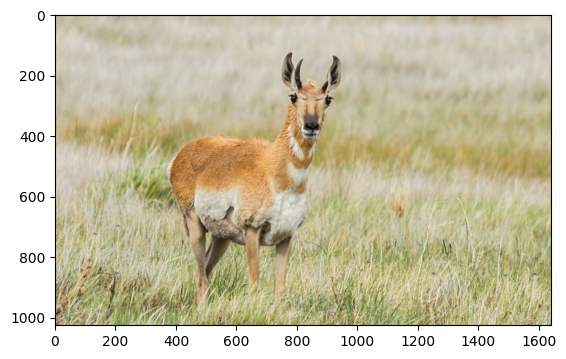

In [27]:
#Taking an Image
image = Image.open(str('/kaggle/input/animal-image-dataset-90-different-animals/animals/animals/antelope/02f4b3be2d.jpg'))
plt.imshow(image)


# Function for Visual


In [28]:
transforms = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ])

def nn_layer_visual(image, model, model_path):
        
        model.load_state_dict(torch.load(model_path))

        
        model_weights =[]
        conv_layers = []
        model_children = list(model.children())
        counter = 0
        for i in range(len(model_children)):
            if type(model_children[i]) == nn.Conv2d:
                counter+=1
                model_weights.append(model_children[i].weight)
                conv_layers.append(model_children[i])
            elif type(model_children[i]) == nn.Sequential:
                for j in range(len(model_children[i])):
                    for child in model_children[i][j].children():
                        if type(child) == nn.Conv2d:
                            counter+=1
                            model_weights.append(child.weight)
                            conv_layers.append(child)
        print(f"Total convolution layers: {counter}")
        print("conv_layers")

        image = transforms(image)
        print(f"Image shape before: {image.shape}")
        image = image.unsqueeze(0)
        print(f"Image shape after: {image.shape}")

        if len(image.shape) == 3:
            image = image.unsqueeze(0)

        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        image = image.to(device)

        print(f"Image shape before: {image.shape}")

        outputs = []
        names = []
        for layer in conv_layers[0:]:
            image = layer(image)
            outputs.append(image)
            names.append(str(layer))

        print(len(outputs))
        for feature_map in outputs:
            print(feature_map.shape)

        processed = []
        for feature_map in outputs:
            feature_map = feature_map.squeeze(0)
            gray_scale = torch.sum(feature_map,0)
            gray_scale = gray_scale / feature_map.shape[0]
            processed.append(gray_scale.data.cpu().numpy())
        for fm in processed:
            print(fm.shape)

        fig = plt.figure(figsize=(30, 50))
        for i in range(len(processed)):
            a = fig.add_subplot(5, 4, i+1)
            imgplot = plt.imshow(processed[i])
            a.axis("off")
            a.set_title(names[i].split('(')[0], fontsize=30)


# Custom CNN Visual

Total convolution layers: 2

conv_layers

Image shape before: torch.Size([3, 224, 224])

Image shape after: torch.Size([1, 3, 224, 224])

Image shape before: torch.Size([1, 3, 224, 224])

2

torch.Size([1, 32, 224, 224])

torch.Size([1, 64, 224, 224])

(224, 224)

(224, 224)


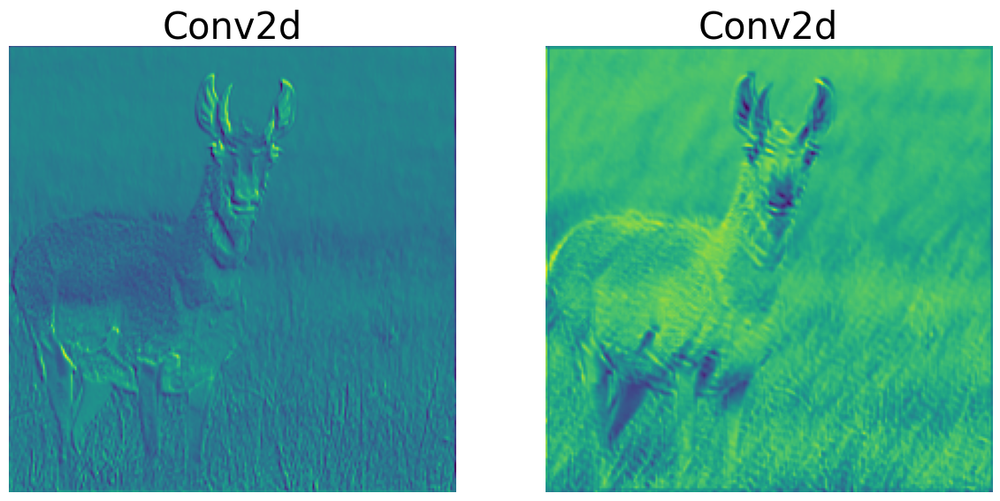

In [29]:
nn_layer_visual(image, model_CustomCNN, '/kaggle/working/5fold_model/CustomCNN.pth')